# Green Public Spaces, Walkability, and Micromobility Infrastructure in Los Angeles

## Introduction 

The research aims to explore the physical and social characteristics of different clustering of green spaces in Los Angeles.

#### Reserach Question: 
- **What are the characteristics of an urban street network that provides high access to green public spaces?**
- What green open space patterns are most accessible by walking and cycling? 
- What policies and urban design approaches can expand the green spaces network?


#### Data set - variables of interests:
In 2016, the Los Angeles County Department Parks and Recreation conducted the Park Needs Assessment (PNA) of the county parks and green spaces. The used data set combines the PNA data about parks and green spaces (PGS), demographics data from 2020, health indicators from CalEnviroScreen of 2018, and sport and recreation trends. The interest variables are park density measured in acres per 1000 individuals, walkable access meaning population percentage living within walkable distance to park (1/2 mile), population, median household income, race, walking and bicycling indices. 

Data source: [Los Angeles County Park Needs Assessment - Demographics](https://egis-lacounty.hub.arcgis.com/datasets/lacounty::l-a-county-park-needs-assessment-demographics/explore?location=33.989010%2C-118.315076%2C11.20&showTable=true).

In [1]:
import numpy as np
import pandas as pd
from scipy import stats
import geopandas as gpd
import seaborn as sns
import matplotlib.pyplot as plt
from cenpy import products

/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/4284639129.py:4: UserWarning: Shapely 2.0 is installed, but because PyGEOS is also installed, GeoPandas will still use PyGEOS by default for now. To force to use and test Shapely 2.0, you have to set the environment variable USE_PYGEOS=0. You can do this before starting the Python process, or in your code before importing geopandas:

import os
os.environ['USE_PYGEOS'] = '0'
import geopandas

In a future release, GeoPandas will switch to using Shapely by default. If you are using PyGEOS directly (calling PyGEOS functions on geometries from GeoPandas), this will then stop working and you are encouraged to migrate from PyGEOS to Shapely 2.0 (https://shapely.readthedocs.io/en/latest/migration_pygeos.html).
  import geopandas as gpd


## 1. Loading and cleaning data

#### 1.1. Los Angeles County Park and Demographics Data

In [2]:
# load data from Los Angles County Park Needs Assessment
gdf = gpd.read_file('data/LACounty_Park_Needs_Assessment_Demographics.geojson').set_index('STUD_AR_ID').sort_index()
gdf.shape

(189, 97)

In [3]:
gdf.head()

,OBJECTID,STUD_AR_NM,STUD_AR_LBL,TOOLKIT_ID,Acres,AC_PER_1K,RepPrkAc,NEED_DESCP,PCT_Walk,aggregationMethod,...,Other_Race,Multi_Race,No_HS,HS_Grad,Some_College,College,unemprt_cy,SHAPE_Length,SHAPE_Area,geometry
STUD_AR_ID,,,,,,,,,,,,,,,,,,,,,
***,189,*Entire Los Angeles County,*Entire Los Angeles County,0,901647.000000,3.3,901647.0,***,49.000000,None,...,0.240195,2.349152,20,21,26,34,16.8,8.853214,1.036248,"MULTIPOLYGON (((-118.42618 32.79991, -118.4261..."
001,176,City of Hidden Hills,City of Hidden Hills,1,1081.772175,0.0,0.0,Not Participating,3.999766,None,...,0.214592,2.038627,3,7,20,70,14.4,0.130363,0.000428,"MULTIPOLYGON (((-118.66526 34.17675, -118.6650..."
002,65,City of Rolling Hills,City of Rolling Hills,2,1914.515827,0.0,0.0,Not Participating,1.323476,None,...,0.211640,2.910053,3,8,17,72,12.8,0.145313,0.000754,"MULTIPOLYGON (((-118.36341 33.76920, -118.3633..."
003,158,City of Vernon / Unincorporated Vernon,City of Vernon / Unic. Vernon,3,3330.368623,0.0,0.0,Very Low,20.859504,None,...,0.000000,0.000000,7,17,45,31,11.9,0.238976,0.001315,"MULTIPOLYGON (((-118.21562 34.01498, -118.2156..."
004,134,Uninc Covina/ Uninc Pomona/ Uninc Charter Oak ...,Unincorporated Covina - Pomona - Charter Oak I...,4,2413.949978,0.0,0.0,Low,14.483366,None,...,0.217649,3.917689,8,17,35,40,19.7,0.365605,0.000954,"MULTIPOLYGON (((-117.85205 34.08087, -117.8519..."


In [4]:
gdf.columns

Index(['OBJECTID', 'STUD_AR_NM', 'STUD_AR_LBL', 'TOOLKIT_ID', 'Acres',
       'AC_PER_1K', 'RepPrkAc', 'NEED_DESCP', 'PCT_Walk', 'aggregationMethod',
       'HasData', 'ORIGINAL_OID', 'sourceCountry',
       'populationtotals_totpop_cy', 'householdtotals_avghhsz_cy',
       'householdincome_medhinc_cy', 'educationalattainment_nohs_cy',
       'educationalattainment_somehs_cy', 'educationalattainment_hsgrad_cy',
       'educationalattainment_ged_cy', 'educationalattainment_smcoll_cy',
       'educationalattainment_asscdeg_c', 'educationalattainment_bachdeg_c',
       'educationalattainment_graddeg_c', 'educationalattainment_educbasec',
       'sports_mp33003a_b_i', 'sports_mp33004a_b_i', 'sports_mp33005a_b_i',
       'sports_mp33012a_b_i', 'sports_mp33014a_b_i', 'sports_mp33015a_b_i',
       'sports_mp33016a_b_i', 'sports_mp33020a_b_i', 'sports_mp33024a_b_i',
       'sports_mp33025a_b_i', 'sports_mp33026a_b_i', 'sports_mp33028a_b_i',
       'sports_mp33029a_b_i', 'sports_mp33030a_b_i',


In [5]:
# drop unnecessary columns
gdf = gdf.drop(columns=['OBJECTID', 'STUD_AR_LBL', 'NEED_DESCP', 'TOOLKIT_ID', 'MEAN_Low_Birth_Weight'])
gdf = gdf.drop(columns = gdf.loc[:, 'aggregationMethod':'sourceCountry'])
gdf = gdf.drop(columns = gdf.loc[:, 'educationalattainment_nohs_cy':'sports_mp33004a_b_i'])
gdf = gdf.drop(columns = gdf.loc[:, 'sports_mp33012a_b_i':'sports_mp33029a_b_i'])
gdf = gdf.drop(columns = gdf.loc[:, 'F5yearincrements_pop0_cy':'Age70upPct'])
gdf = gdf.drop(columns = gdf.loc[:, 'No_HS':'SHAPE_Area'])
gdf

,STUD_AR_NM,Acres,AC_PER_1K,RepPrkAc,PCT_Walk,populationtotals_totpop_cy,householdtotals_avghhsz_cy,householdincome_medhinc_cy,sports_mp33005a_b_i,sports_mp33030a_b_i,HispanicPct,WhitePct,Black_Pct,Asian_Pct,Am_Indian,Pac_Island,Other_Race,Multi_Race,geometry
STUD_AR_ID,,,,,,,,,,,,,,,,,,,
***,*Entire Los Angeles County,901647.000000,3.300000,901647.000,49.000000,10172564.0,2.99,69788.0,94,92,48.953460,25.487389,7.753178,14.817375,0.178687,0.220564,0.240195,2.349152,"MULTIPOLYGON (((-118.42618 32.79991, -118.4261..."
001,City of Hidden Hills,1081.772175,0.000000,0.000,3.999766,1864.0,3.14,200001.0,121,149,8.047210,84.120172,1.931330,3.487124,0.160944,0.053648,0.214592,2.038627,"MULTIPOLYGON (((-118.66526 34.17675, -118.6650..."
002,City of Rolling Hills,1914.515827,0.000000,0.000,1.323476,1890.0,2.82,200001.0,121,149,6.084656,69.894180,1.428571,19.365079,0.000000,0.105820,0.211640,2.910053,"MULTIPOLYGON (((-118.36341 33.76920, -118.3633..."
003,City of Vernon / Unincorporated Vernon,3330.368623,0.000000,0.000,20.859504,118.0,4.07,82759.0,125,116,46.610169,48.305085,3.389831,1.694915,0.000000,0.000000,0.000000,0.000000,"MULTIPOLYGON (((-118.21562 34.01498, -118.2156..."
004,Uninc Covina/ Uninc Pomona/ Uninc Charter Oak ...,2413.949978,0.000000,0.000,14.483366,5054.0,3.24,105195.0,118,108,36.070439,36.208943,3.363672,19.964385,0.118718,0.118718,0.217649,3.917689,"MULTIPOLYGON (((-117.85205 34.08087, -117.8519..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
184,City of Cerritos \ Unincorporated Cerritos,5685.595586,4.400000,220.600,83.743853,50515.0,3.17,107321.0,77,124,12.218153,13.884985,5.881421,64.622389,0.095021,0.229635,0.148471,2.921904,"MULTIPOLYGON (((-118.03768 33.88737, -118.0367..."
185,City of LA San Pedro / City of LA Port of Los ...,8333.631297,8.744505,725.995,88.963368,82431.0,2.58,70935.0,102,101,49.162330,35.294974,5.648360,5.762395,0.321481,0.348170,0.243840,3.219663,"MULTIPOLYGON (((-118.26739 33.70366, -118.2674..."
186,City of Redondo Beach,3970.933566,1.368521,92.679,87.336943,67740.0,2.32,120818.0,132,122,16.827576,60.683496,2.599646,13.810156,0.237673,0.270151,0.417774,5.152052,"MULTIPOLYGON (((-118.36585 33.89463, -118.3613..."


In [6]:
# rename columns
gdf = gdf.rename(columns={'STUD_AR_ID':'AreaID', 'STUD_AR_NM':'Community', 'AC_PER_1K':'Acres_per1000', 
                        'RepPrkAc':'ParkAcres', 'PCT_Walk':'Walkable_pct', 
                        'populationtotals_totpop_cy':'Total_Pop', 'householdtotals_avghhsz_cy':'Av_HouseSize', 
                        'householdincome_medhinc_cy':'MedHouse_Income', 
                        'sports_mp33005a_b_i':'Bicycling_Index', 'sports_mp33030a_b_i':'Walking_Index',
                        'MEAN_Asthma':'MeanAstma', 'MEAN_Cardiovascular':'MeanCardiovascular'})

In [7]:
# create a column of accessible parks percentage
gdf['Park_pct'] = gdf['ParkAcres'] / gdf['Acres'] * 100

# calculate park per 1000 with updated population column of the 2020 year data
gdf['AcresPer1000'] = gdf['ParkAcres'] / (gdf['Total_Pop'] / 1000)

# create population density column
gdf['Pop_Density'] = gdf['Total_Pop'] / gdf['Acres'] 

gdf.head(2)

,Community,Acres,Acres_per1000,ParkAcres,Walkable_pct,Total_Pop,Av_HouseSize,MedHouse_Income,Bicycling_Index,Walking_Index,...,Black_Pct,Asian_Pct,Am_Indian,Pac_Island,Other_Race,Multi_Race,geometry,Park_pct,AcresPer1000,Pop_Density
STUD_AR_ID,,,,,,,,,,,,,,,,,,,,,
***,*Entire Los Angeles County,901647.000000,3.3,901647.0,49.000000,10172564.0,2.99,69788.0,94,92,...,7.753178,14.817375,0.178687,0.220564,0.240195,2.349152,"MULTIPOLYGON (((-118.42618 32.79991, -118.4261...",100.0,88.635176,11.282202
001,City of Hidden Hills,1081.772175,0.0,0.0,3.999766,1864.0,3.14,200001.0,121,149,...,1.931330,3.487124,0.160944,0.053648,0.214592,2.038627,"MULTIPOLYGON (((-118.66526 34.17675, -118.6650...",0.0,0.000000,1.723098


In [8]:
# move some columns for clarity
cols = gdf.columns[0:4].to_list() + [gdf.columns[-3]] + [gdf.columns[-2]] + gdf.columns[4:6].to_list() + [gdf.columns[-1]] + gdf.columns[6:-3].to_list()
gdf = gdf.reindex(columns=cols)

# drop initial Acres per 1000, leave only calculated by updated total population
gdf = gdf.drop(columns=['Acres_per1000'])
gdf.head()

,Community,Acres,ParkAcres,Park_pct,AcresPer1000,Walkable_pct,Total_Pop,Pop_Density,Av_HouseSize,MedHouse_Income,...,Walking_Index,HispanicPct,WhitePct,Black_Pct,Asian_Pct,Am_Indian,Pac_Island,Other_Race,Multi_Race,geometry
STUD_AR_ID,,,,,,,,,,,,,,,,,,,,,
***,*Entire Los Angeles County,901647.000000,901647.0,100.0,88.635176,49.000000,10172564.0,11.282202,2.99,69788.0,...,92,48.953460,25.487389,7.753178,14.817375,0.178687,0.220564,0.240195,2.349152,"MULTIPOLYGON (((-118.42618 32.79991, -118.4261..."
001,City of Hidden Hills,1081.772175,0.0,0.0,0.000000,3.999766,1864.0,1.723098,3.14,200001.0,...,149,8.047210,84.120172,1.931330,3.487124,0.160944,0.053648,0.214592,2.038627,"MULTIPOLYGON (((-118.66526 34.17675, -118.6650..."
002,City of Rolling Hills,1914.515827,0.0,0.0,0.000000,1.323476,1890.0,0.987195,2.82,200001.0,...,149,6.084656,69.894180,1.428571,19.365079,0.000000,0.105820,0.211640,2.910053,"MULTIPOLYGON (((-118.36341 33.76920, -118.3633..."
003,City of Vernon / Unincorporated Vernon,3330.368623,0.0,0.0,0.000000,20.859504,118.0,0.035432,4.07,82759.0,...,116,46.610169,48.305085,3.389831,1.694915,0.000000,0.000000,0.000000,0.000000,"MULTIPOLYGON (((-118.21562 34.01498, -118.2156..."
004,Uninc Covina/ Uninc Pomona/ Uninc Charter Oak ...,2413.949978,0.0,0.0,0.000000,14.483366,5054.0,2.093664,3.24,105195.0,...,108,36.070439,36.208943,3.363672,19.964385,0.118718,0.118718,0.217649,3.917689,"MULTIPOLYGON (((-117.85205 34.08087, -117.8519..."


In [9]:
gdf.dtypes

Community            object
Acres               float64
ParkAcres           float64
Park_pct            float64
AcresPer1000        float64
Walkable_pct        float64
Total_Pop           float64
Pop_Density         float64
Av_HouseSize        float64
MedHouse_Income     float64
Bicycling_Index       int64
Walking_Index         int64
HispanicPct         float64
WhitePct            float64
Black_Pct           float64
Asian_Pct           float64
Am_Indian           float64
Pac_Island          float64
Other_Race          float64
Multi_Race          float64
geometry           geometry
dtype: object

In [10]:
# assign integer type to some columns
gdf['Total_Pop'] =gdf['Total_Pop'].astype(int)
gdf['MedHouse_Income'] = gdf['MedHouse_Income'].astype(int)

In [11]:
# assign integer type to Walkable Percentage, Mean Astma, Mean Cardiovascular
slicer = pd.IndexSlice[:, 'Acres':'Walkable_pct']
gdf.loc[slicer] = gdf.loc[slicer].round(2)

slicer2 = pd.IndexSlice[:, 'HispanicPct':'Multi_Race']
gdf.loc[slicer2] = gdf.loc[slicer2].round(2)

gdf['Pop_Density'] = gdf['Pop_Density'].round(2)

gdf.head()

,Community,Acres,ParkAcres,Park_pct,AcresPer1000,Walkable_pct,Total_Pop,Pop_Density,Av_HouseSize,MedHouse_Income,...,Walking_Index,HispanicPct,WhitePct,Black_Pct,Asian_Pct,Am_Indian,Pac_Island,Other_Race,Multi_Race,geometry
STUD_AR_ID,,,,,,,,,,,,,,,,,,,,,
***,*Entire Los Angeles County,901647.00,901647.0,100.0,88.64,49.00,10172564,11.28,2.99,69788,...,92,48.95,25.49,7.75,14.82,0.18,0.22,0.24,2.35,"MULTIPOLYGON (((-118.42618 32.79991, -118.4261..."
001,City of Hidden Hills,1081.77,0.0,0.0,0.00,4.00,1864,1.72,3.14,200001,...,149,8.05,84.12,1.93,3.49,0.16,0.05,0.21,2.04,"MULTIPOLYGON (((-118.66526 34.17675, -118.6650..."
002,City of Rolling Hills,1914.52,0.0,0.0,0.00,1.32,1890,0.99,2.82,200001,...,149,6.08,69.89,1.43,19.37,0.00,0.11,0.21,2.91,"MULTIPOLYGON (((-118.36341 33.76920, -118.3633..."
003,City of Vernon / Unincorporated Vernon,3330.37,0.0,0.0,0.00,20.86,118,0.04,4.07,82759,...,116,46.61,48.31,3.39,1.69,0.00,0.00,0.00,0.00,"MULTIPOLYGON (((-118.21562 34.01498, -118.2156..."
004,Uninc Covina/ Uninc Pomona/ Uninc Charter Oak ...,2413.95,0.0,0.0,0.00,14.48,5054,2.09,3.24,105195,...,108,36.07,36.21,3.36,19.96,0.12,0.12,0.22,3.92,"MULTIPOLYGON (((-117.85205 34.08087, -117.8519..."


In [12]:
# delete 'City of' in Community column
gdf['Community'] = gdf['Community'].str.replace('City of ', '').str.replace('Unincorporated ', '')

In [13]:
# drop the Entire LA County row
mask1 = gdf['Community'] == '*Entire Los Angeles County' 
mask2 = gdf['Community'] == 'Avalon / Channel Islands North'
mask = mask1 + mask2
gdf.drop(gdf[mask].index, inplace = True)
gdf

,Community,Acres,ParkAcres,Park_pct,AcresPer1000,Walkable_pct,Total_Pop,Pop_Density,Av_HouseSize,MedHouse_Income,...,Walking_Index,HispanicPct,WhitePct,Black_Pct,Asian_Pct,Am_Indian,Pac_Island,Other_Race,Multi_Race,geometry
STUD_AR_ID,,,,,,,,,,,,,,,,,,,,,
001,Hidden Hills,1081.77,0.00,0.00,0.00,4.00,1864,1.72,3.14,200001,...,149,8.05,84.12,1.93,3.49,0.16,0.05,0.21,2.04,"MULTIPOLYGON (((-118.66526 34.17675, -118.6650..."
002,Rolling Hills,1914.52,0.00,0.00,0.00,1.32,1890,0.99,2.82,200001,...,149,6.08,69.89,1.43,19.37,0.00,0.11,0.21,2.91,"MULTIPOLYGON (((-118.36341 33.76920, -118.3633..."
003,Vernon / Vernon,3330.37,0.00,0.00,0.00,20.86,118,0.04,4.07,82759,...,116,46.61,48.31,3.39,1.69,0.00,0.00,0.00,0.00,"MULTIPOLYGON (((-118.21562 34.01498, -118.2156..."
004,Uninc Covina/ Uninc Pomona/ Uninc Charter Oak ...,2413.95,0.00,0.00,0.00,14.48,5054,2.09,3.24,105195,...,108,36.07,36.21,3.36,19.96,0.12,0.12,0.22,3.92,"MULTIPOLYGON (((-117.85205 34.08087, -117.8519..."
005,Covina Islands,361.91,0.00,0.00,0.00,3.72,5501,15.20,3.82,85498,...,77,72.22,14.80,2.22,9.02,0.04,0.25,0.27,1.20,"MULTIPOLYGON (((-117.92540 34.09931, -117.9254..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
184,Cerritos \ Cerritos,5685.60,220.60,3.88,4.37,83.74,50515,8.88,3.17,107321,...,124,12.22,13.88,5.88,64.62,0.10,0.23,0.15,2.92,"MULTIPOLYGON (((-118.03768 33.88737, -118.0367..."
185,LA San Pedro / LA Port of Los Angeles / La Rambla,8333.63,726.00,8.71,8.81,88.96,82431,9.89,2.58,70935,...,101,49.16,35.29,5.65,5.76,0.32,0.35,0.24,3.22,"MULTIPOLYGON (((-118.26739 33.70366, -118.2674..."
186,Redondo Beach,3970.93,92.68,2.33,1.37,87.34,67740,17.06,2.32,120818,...,122,16.83,60.68,2.60,13.81,0.24,0.27,0.42,5.15,"MULTIPOLYGON (((-118.36585 33.89463, -118.3613..."


In [14]:
# check if all values in Community column are qniue
gdf['Community'].is_unique
non_unique = gdf[gdf.duplicated(subset=['Community'], keep=False)]
print(f'{len(non_unique)} are non-unique rows:\n{non_unique}')

4 are non-unique rows:
           Community    Acres  ParkAcres  Park_pct  AcresPer1000  \
STUD_AR_ID                                                         
012          Compton  1728.54       8.44      0.49          3.13   
127            Azusa  1002.12      41.78      4.17          2.56   
142          Compton  6464.16      56.56      0.87          0.58   
175            Azusa  6183.20    2056.06     33.25         40.33   

            Walkable_pct  Total_Pop  Pop_Density  Av_HouseSize  \
STUD_AR_ID                                                       
012                 3.46       2701         1.56          2.58   
127                61.41      16338        16.30          4.47   
142                58.39      98228        15.20          4.18   
175                72.00      50978         8.24          3.46   

            MedHouse_Income  ...  Walking_Index  HispanicPct  WhitePct  \
STUD_AR_ID                   ...                                         
012                   6

In [15]:
# change name of Communities by aligning with PNA original data set
gdf.at['127', 'Community'] = 'Uninvorporated Azusa'
gdf.at['012', 'Community'] = 'Uninvorporated Compton'

# check that these rows have unique community names now 
print(gdf.loc[['012', '127', '142', '175'], ['Community']])

                         Community
STUD_AR_ID                        
012         Uninvorporated Compton
127           Uninvorporated Azusa
142                        Compton
175                          Azusa


In [16]:
# save geojson cleaned data file
gdf.to_file('data/LA_County_PNA.geojson', driver='GeoJSON')

In [17]:
# copy file for further analysis in this notebook
pna = gdf.copy()

## 2. Descriptive Statistics

### 2.1. Analysis of the entire data set

In [26]:
# set the style for graphics  
sns.set_context('paper')
sns.set_style('whitegrid')

In [27]:
pna['Acres'].sum()

2529350.76

In [28]:
pna['ParkAcres'].sum()

49238.82

In [29]:
(pna['ParkAcres'].sum() / pna['Acres'].sum()) * 100

1.946697973989183

In [30]:
pna['MedHouse_Income'] = pna['MedHouse_Income'] / 1000

In [31]:
# descriptive statistics of each variable 
pna.describe().round(2)

,Acres,ParkAcres,Park_pct,AcresPer1000,Walkable_pct,Total_Pop,Pop_Density,Av_HouseSize,MedHouse_Income,Bicycling_Index,Walking_Index,HispanicPct,WhitePct,Black_Pct,Asian_Pct,Am_Indian,Pac_Island,Other_Race,Multi_Race
count,187.00,187.00,187.00,187.00,187.00,187.00,187.00,187.00,187.00,187.00,187.00,187.00,187.00,187.00,187.00,187.00,187.00,187.00,187.00
mean,13525.94,263.31,3.44,18.12,46.05,54381.42,12.83,3.16,83.09,96.12,96.66,45.20,29.88,6.76,15.10,0.19,0.21,0.22,2.43
std,36694.14,693.83,6.81,107.11,24.39,40677.15,10.11,0.72,36.37,20.38,28.92,27.94,24.98,10.73,15.41,0.12,0.34,0.10,1.45
min,361.91,0.00,0.00,0.00,0.00,118.00,0.01,1.53,33.36,47.00,41.00,5.22,0.57,0.15,0.15,0.00,0.00,0.00,0.00
25%,2256.22,24.54,0.78,0.64,27.77,19838.50,4.42,2.62,55.89,77.00,73.50,20.30,6.78,1.33,4.89,0.12,0.06,0.15,1.20
50%,4648.34,77.86,1.48,1.43,45.27,49528.00,11.58,3.04,76.32,96.00,99.00,39.21,24.62,3.17,10.52,0.16,0.11,0.21,2.44
75%,8942.55,169.22,3.32,3.94,61.83,82467.00,18.23,3.64,101.52,113.00,119.00,69.20,50.31,7.14,19.40,0.24,0.18,0.27,3.50
max,310558.73,5407.24,52.22,1290.45,100.00,189778.00,60.43,5.04,200.00,162.00,150.00,97.77,84.12,77.74,67.86,0.74,2.35,0.56,5.54


Variable of Acres per 1000 persons has high standard deviation score and it can be unevenly distributed. Let's check it in the box plot and 

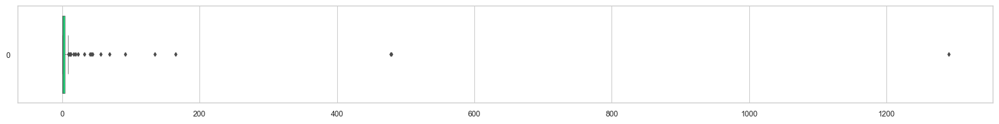

In [32]:
# visualize distribution of park density (acres per 1000 persons)
fig, ax = plt.subplots(figsize=(20, 2))
ax = sns.boxplot(data=pna['AcresPer1000'], color='springgreen', linewidth=0.5, orient='h', fliersize=3)

The are couple of outliers who might contribute to distortions in statistics.

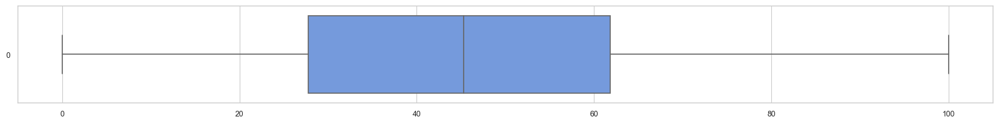

In [33]:
# check outliers in the walking accessability percentage variable 
# walkability means what portion of population live within 1/2 mile (10-15 minutes walk)
fig, ax = plt.subplots(figsize=(20, 2))
ax = sns.boxplot(data=pna['Walkable_pct'], color='cornflowerblue', orient='h', fliersize=2)

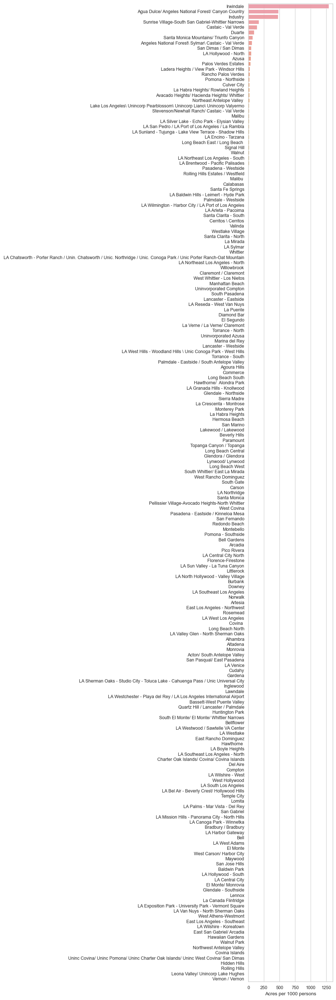

In [34]:
# bar plot density of green spaces in each community to identify outliers
order = pna.groupby('Community')['AcresPer1000'].mean().sort_values(ascending=False).index
ax = sns.barplot(x=pna['AcresPer1000'],
                 y=pna['Community'],
                 estimator=np.mean,
                 errorbar=('ci', 95),
                 order=order,
                 alpha=0.9)

ax.set_xlabel('Acres per 1000 persons')
ax.set_ylabel('')
ax.get_figure().set_size_inches(3, 35)

### 2.2. Analysis of the data subset of urban (city) communities
The research aims to analyze park and green spaces distribution in urbanized communities. Therefore, some communities with high park acres dinsity and low population were excluded.

In [35]:
# create a mask to select only highly 'urbanized areas' without outliers
# the first criterion is to de-select communities from the top of the bar plot that are explicitly located in mountains
# leave only communities with less than 50 acres per 1000 persons
mask_urban = pna['AcresPer1000'] < 50
pna_urban = pna[mask_urban]
pna_urban.shape

(179, 21)

In [36]:
# clean some communities names
pna_urban.loc['035', 'Community'] = 'Lake Los Angeles - Pearblossom - Liano - Valyermo'

In [37]:
# clean some communities names
pna_urban.loc['152','Community'] = 'LA Chatsworth - Porter Ranch - Northridge - Canoga Park - Oat Mountain'

In [38]:
# clean some communities names
pna_urban['Community'] = pna_urban['Community'].str.replace('Uninc Covina/ Uninc Pomona/ Uninc Charter Oak Islands/ Uninc West Covina/ San Dimas', 'Covina - Pomona - Charter OakIslands - West Covina - San Dimas')

/Users/1/mambaforge/envs/ppd599/lib/python3.10/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


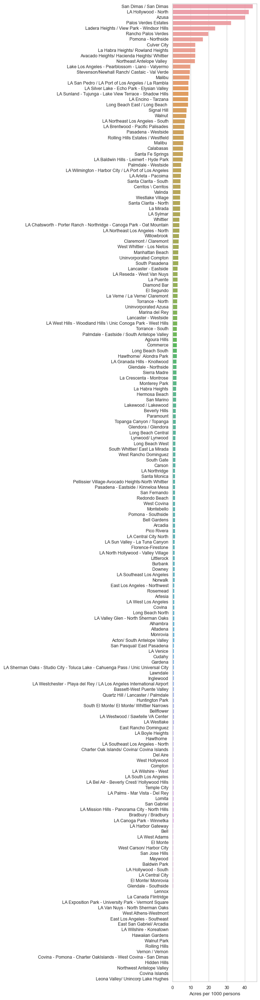

In [39]:
# bar plot density of green spaces in urban communities
order = pna_urban.groupby('Community')['AcresPer1000'].mean().sort_values(ascending=False).index
ax = sns.barplot(x=pna_urban['AcresPer1000'],
                 y=pna_urban['Community'],
                 estimator=np.mean,
                 errorbar=('ci', 95),
                 order=order,
                 alpha=0.9)

ax.set_xlabel('Acres per 1000 persons')
ax.set_ylabel('')
ax.get_figure().set_size_inches(3, 35)

plt.savefig('images/urban_communities_acresperson.png', dpi=800, bbox_inches='tight')

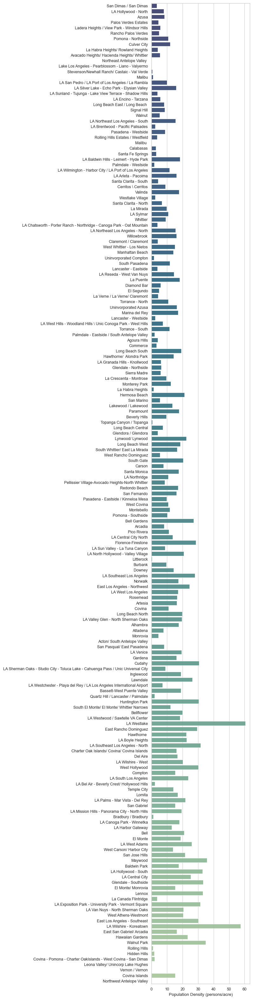

In [167]:
# order community by the park density
order = pna_urban.groupby('Community')['Pop_Density'].mean().sort_values(ascending=False).index

# Sort the order variable by another variable in ascending order
order = pd.DataFrame({'Community': order})
order = order.merge(pna_urban.groupby('Community')['AcresPer1000'].mean().reset_index(), on='Community')
order = order.sort_values(by='AcresPer1000', ascending=False)['Community']

# bar plot population density in each community by Park density descending order
ax = sns.barplot(x=pna_urban['Pop_Density'],
                 y=pna_urban['Community'],
                 estimator=np.mean,
                 errorbar=('ci', 95),
                 order=order,
                 palette='crest_r',
                 alpha=0.9)

ax.set_xlabel('Population Density (persons/acre)')
ax.set_ylabel('')
ax.get_figure().set_size_inches(4,40)
plt.savefig('images/urban_communities_popdensity2.png', dpi=800, bbox_inches='tight')

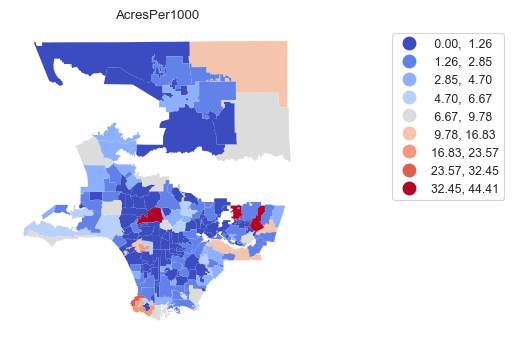

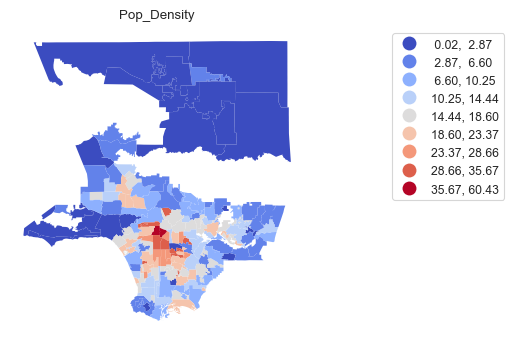

In [41]:
# visual comparisson of population density and parc acres density
cols = ['AcresPer1000', 'Pop_Density']
for col in cols:
    ax = pna_urban.dropna(subset=[col]).plot(column=col,
                                             scheme='NaturalBreaks',
                                             k=9,
                                             cmap='coolwarm',
                                             figsize=(4, 4),
                                             linewidth=0,
                                             legend=True,
                                             legend_kwds={'bbox_to_anchor': (1.7, 1)})
    ax.set_title(col)
    _ = ax.axis('off')

In [42]:
# calculate correlation coefficient and p-value
subset = pna_urban.dropna(subset=['AcresPer1000', 'Pop_Density'])
r, p = stats.pearsonr(x=subset['AcresPer1000'],
                      y=subset['Pop_Density'])
print('r={:.4f}, p={:.4f}'.format(r, p))

r=-0.2807, p=0.0001


In [43]:
# now look at the descriptive stats of defined urban communities
pna_urban_stats = pna_urban.describe().round(2)
pna_urban_stats

,Acres,ParkAcres,Park_pct,AcresPer1000,Walkable_pct,Total_Pop,Pop_Density,Av_HouseSize,MedHouse_Income,Bicycling_Index,Walking_Index,HispanicPct,WhitePct,Black_Pct,Asian_Pct,Am_Indian,Pac_Island,Other_Race,Multi_Race
count,179.00,179.00,179.00,179.00,179.00,179.00,179.00,179.00,179.00,179.00,179.00,179.00,179.00,179.00,179.00,179.00,179.00,179.00,179.00
mean,10513.84,182.12,2.82,3.49,47.00,56302.88,13.35,3.16,82.56,96.12,96.32,45.20,29.70,6.92,15.11,0.19,0.21,0.23,2.44
std,26545.05,409.27,4.50,6.59,24.04,40436.42,10.02,0.73,36.63,20.27,29.24,28.08,24.90,10.93,15.45,0.11,0.34,0.10,1.47
min,361.91,0.00,0.00,0.00,0.00,118.00,0.02,1.53,33.36,47.00,41.00,5.22,0.57,0.15,0.15,0.00,0.00,0.00,0.00
25%,2215.53,21.34,0.75,0.62,29.54,20613.00,5.41,2.60,54.73,77.00,73.00,19.93,6.78,1.36,4.80,0.12,0.06,0.15,1.20
50%,4552.37,70.95,1.42,1.37,46.02,53158.00,12.04,3.04,76.26,96.00,98.00,39.21,24.62,3.21,10.52,0.16,0.11,0.21,2.44
75%,8497.38,152.45,3.09,3.24,62.10,82962.00,18.50,3.68,100.77,113.00,119.00,69.20,50.31,7.53,19.46,0.23,0.18,0.28,3.56
max,207680.22,4322.68,33.70,44.41,100.00,189778.00,60.43,5.04,200.00,162.00,150.00,97.77,84.12,77.74,67.86,0.64,2.35,0.56,5.54


In [44]:
# how many communities have neither walkable access to park or acres
mask1 = pna_urban['AcresPer1000'] == 0
mask2 = pna_urban['Walkable_pct'] == 0
pna_urban[mask1 | mask2]

,Community,Acres,ParkAcres,Park_pct,AcresPer1000,Walkable_pct,Total_Pop,Pop_Density,Av_HouseSize,MedHouse_Income,...,Walking_Index,HispanicPct,WhitePct,Black_Pct,Asian_Pct,Am_Indian,Pac_Island,Other_Race,Multi_Race,geometry
STUD_AR_ID,,,,,,,,,,,,,,,,,,,,,
001,Hidden Hills,1081.77,0.0,0.0,0.0,4.00,1864,1.72,3.14,200.001,...,149,8.05,84.12,1.93,3.49,0.16,0.05,0.21,2.04,"MULTIPOLYGON (((-118.66526 34.17675, -118.6650..."
002,Rolling Hills,1914.52,0.0,0.0,0.0,1.32,1890,0.99,2.82,200.001,...,149,6.08,69.89,1.43,19.37,0.00,0.11,0.21,2.91,"MULTIPOLYGON (((-118.36341 33.76920, -118.3633..."
003,Vernon / Vernon,3330.37,0.0,0.0,0.0,20.86,118,0.04,4.07,82.759,...,116,46.61,48.31,3.39,1.69,0.00,0.00,0.00,0.00,"MULTIPOLYGON (((-118.21562 34.01498, -118.2156..."
004,Covina - Pomona - Charter OakIslands - West Co...,2413.95,0.0,0.0,0.0,14.48,5054,2.09,3.24,105.195,...,108,36.07,36.21,3.36,19.96,0.12,0.12,0.22,3.92,"MULTIPOLYGON (((-117.85205 34.08087, -117.8519..."
005,Covina Islands,361.91,0.0,0.0,0.0,3.72,5501,15.20,3.82,85.498,...,77,72.22,14.80,2.22,9.02,0.04,0.25,0.27,1.20,"MULTIPOLYGON (((-117.92540 34.09931, -117.9254..."
006,Leona Valley/ Unincorp Lake Hughes,38945.73,0.0,0.0,0.0,0.00,4369,0.11,2.58,87.181,...,109,20.58,66.47,4.92,3.85,0.37,0.05,0.18,3.59,"MULTIPOLYGON (((-118.36227 34.65958, -118.3620..."
018,Northwest Antelope Valley,197856.78,0.0,0.0,0.0,0.51,4723,0.02,2.71,78.934,...,117,27.06,62.25,4.13,2.88,0.64,0.06,0.30,2.71,"MULTIPOLYGON (((-118.87706 34.80346, -118.8543..."


In [45]:
pna_urban_stats.to_csv('data/pna_urban_stats.csv')

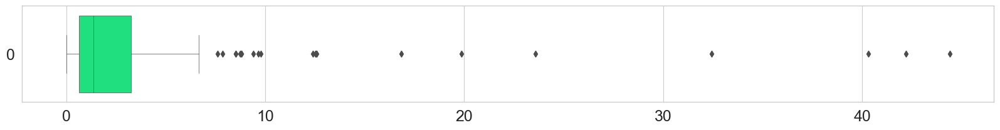

In [46]:
# visualize distribution of park density (acres per 1000 persons)
fig, ax = plt.subplots(figsize=(20, 2))
ax = sns.boxplot(data=pna_urban['AcresPer1000'], color='springgreen', linewidth=0.5, orient='h', fliersize=5)

# modify fonts and save figure
plt.tick_params(axis='both', labelsize=18) 
fig.savefig('images/urban_communities_boxplot_parksdensity.png', dpi=800, bbox_inches='tight')

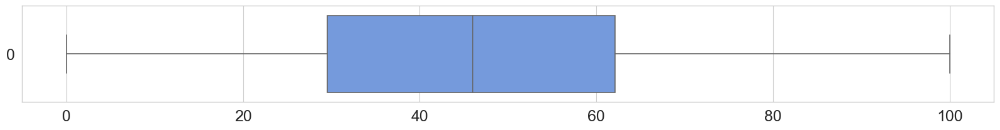

In [47]:
# check outliers in the walking accessability percentage variable 
# walkability means what portion of population live within 1/2 mile (10-15 minutes walk)
fig, ax = plt.subplots(figsize=(20, 2))
ax = sns.boxplot(data=pna_urban['Walkable_pct'], color='cornflowerblue', orient='h', fliersize=5)

# modify fonts and save figure
plt.tick_params(axis='both', labelsize=18) 
fig.savefig('images/urban_communities_boxplot_walkability.png', dpi=800, bbox_inches='tight')

This section aims to describe relationships between socio-economical characteristics of communities and their access to green public spaces.

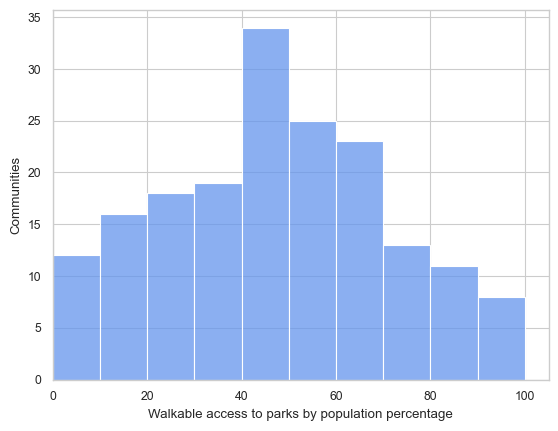

In [168]:
# histplot visualizes the variable's distribution as a histogram and optionally a KDE
ax = sns.histplot(pna_urban['Walkable_pct'].dropna(), kde=False, bins=10, color='cornflowerblue')
_ = ax.set_xlim(left=0)
ax.set_xlabel('Walkable access to parks by population percentage')
ax.set_ylabel('Communities')

#save histograpm plot
plt.savefig('images/urban_communities_histplot_walkability.png', dpi=800, bbox_inches='tight')

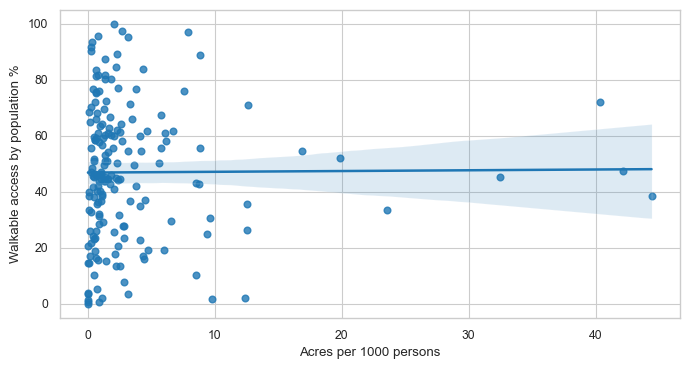

In [49]:
# look at the relation of park density and its walkability for the population around it
ax = sns.regplot(x=pna_urban['AcresPer1000'], y=pna_urban['Walkable_pct'])
ax.get_figure().set_size_inches(8, 4)

ax.set_xlabel('Acres per 1000 persons')
ax.set_ylabel('Walkable access by population %')
plt.savefig('images/urban_communities_regplot_AcresWalkability.png', dpi=800, bbox_inches='tight')

In [50]:
# check the correlation coefficient values of median income and walkability 
r, p = stats.pearsonr(x=pna_urban['AcresPer1000'], y=pna_urban['Walkable_pct'])
print(round(r, 3), round(p, 3))

0.008 0.921


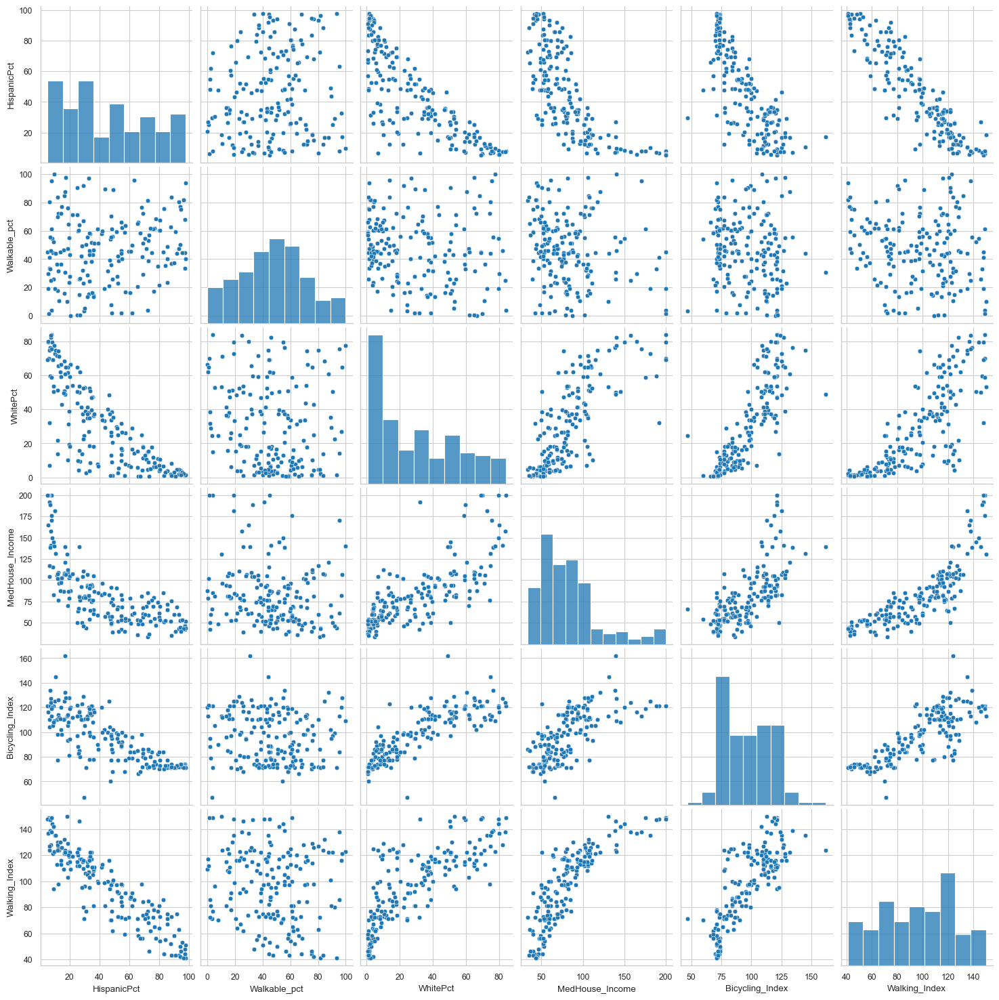

In [51]:
# What are the relationships between three variables of interest?
cols = ['HispanicPct','Walkable_pct', 'WhitePct', 'MedHouse_Income', 'Bicycling_Index', 'Walking_Index']
ax = sns.pairplot(pna_urban[cols].dropna()) 

- Median Household Income and Walkable access to GPS is vague. Walkable pecentage does not strongly depend on any of the included variables
- Median Household Income seems to positively correlate with Walking and Bicycling Indices
- Hispanic, Walking and Bicycling Indices are negatively related
- It seems like Bicycling index and Walking index have high correlation. Check their Pearson correlation coefficients and make a linear regression analysis.

In [52]:
# check the correlation coefficient values of median income and walkability 
r, p = stats.pearsonr(x=pna_urban['MedHouse_Income'], y=pna_urban['Walkable_pct'])
print(round(r, 3), round(p, 3))

-0.178 0.017


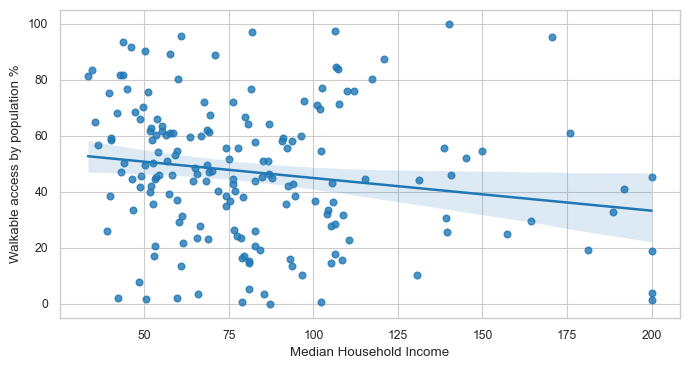

In [53]:
ax = sns.regplot(x=pna_urban['MedHouse_Income'], y=pna_urban['Walkable_pct'])
ax.get_figure().set_size_inches(8, 4)

ax.set_xlabel('Median Household Income')
ax.set_ylabel('Walkable access by population %')

plt.savefig('images/urban_communities_regplot_MedincomeWalkability.png', dpi=800, bbox_inches='tight')

In [54]:
# check the correlation coefficient values of median income and walkability 
r, p = stats.pearsonr(x=pna_urban['AcresPer1000'], y=pna_urban['Pop_Density'])
print(round(r, 4), round(p, 4))

-0.2807 0.0001


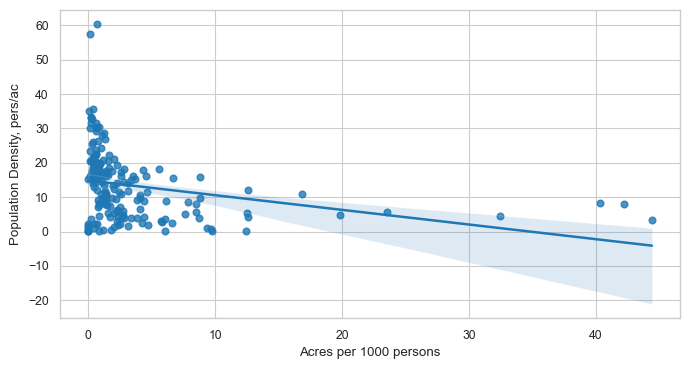

In [55]:
ax = sns.regplot(x=pna_urban['AcresPer1000'], y=pna_urban['Pop_Density'])
ax.get_figure().set_size_inches(8, 4)

ax.set_xlabel('Acres per 1000 persons')
ax.set_ylabel('Population Density, pers/ac')

plt.savefig('images/urban_communities_regplot_Acresper1000PopDensity.png', dpi=800, bbox_inches='tight')

In [56]:
# check the correlation coefficient of walking and bicycling indices 
r, p = stats.pearsonr(x=pna_urban['Walking_Index'], y=pna_urban['Bicycling_Index'])
print(round(r, 3), round(p, 3)) 

0.807 0.0


In [57]:
# look at the r correlation value of all variables form the pair plot
correlation = pna_urban[cols].corr()
correlation.round(3)

,HispanicPct,Walkable_pct,WhitePct,MedHouse_Income,Bicycling_Index,Walking_Index
HispanicPct,1.000,0.142,-0.795,-0.716,-0.775,-0.906
Walkable_pct,0.142,1.000,-0.168,-0.178,-0.124,-0.166
WhitePct,-0.795,-0.168,1.000,0.760,0.845,0.781
MedHouse_Income,-0.716,-0.178,0.760,1.000,0.698,0.826
Bicycling_Index,-0.775,-0.124,0.845,0.698,1.000,0.807
Walking_Index,-0.906,-0.166,0.781,0.826,0.807,1.000


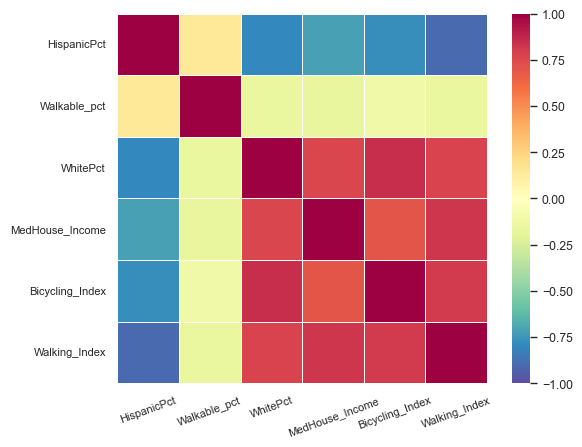

In [58]:
ax = sns.heatmap(correlation, vmin=-1, vmax=1, center=0,
                cmap='Spectral_r', square=True, linewidths=0.6)
ax.tick_params(axis='x', labelsize=8, labelrotation=20)
ax.tick_params(axis='y',labelsize=8)

plt.savefig('images/urban_communities_heatmap_corr.png', dpi=800, bbox_inches='tight')

- Wlkable acceess has not significant correlation with any other variable
- Walking and Bicycling indices corellate with each other. Plus Median Household income corellates with these indices. 
- Walking Index has by 0.1 points higher corellation with Median Household Income than Bicycling Index.
- Hispanic Percentage has negative correlation with every other variable.

### 2.3. Identifying six case study areas

For the further street network analysis, six communities with various spatial, soical, and economic characteristics were extracted. 

In [59]:
# masks for site selection criteria: high population density and median park density
mask1 = pna_urban['Pop_Density'] > 12 # more than 75 percentile  
mask2 = pna_urban['Walkable_pct'] > 60 
mask3 = pna_urban['AcresPer1000'] > 3.5 # (5 acres recomended, 3.5 is the minimum standard for over one million population areas https://www.planning.org/pas/reports/report194.htm
mask = mask1 & mask2 & mask3

pna_urban[mask]

,Community,Acres,ParkAcres,Park_pct,AcresPer1000,Walkable_pct,Total_Pop,Pop_Density,Av_HouseSize,MedHouse_Income,...,Walking_Index,HispanicPct,WhitePct,Black_Pct,Asian_Pct,Am_Indian,Pac_Island,Other_Race,Multi_Race,geometry
STUD_AR_ID,,,,,,,,,,,,,,,,,,,,,
172,Culver City,3286.18,497.89,15.15,12.59,71.00,39557,12.04,2.32,101.186,...,115,25.22,43.62,8.78,16.58,0.16,0.19,0.54,4.92,"MULTIPOLYGON (((-118.37158 34.03067, -118.3718..."
177,LA Northeast Los Angeles - South,6066.58,628.53,10.36,6.67,61.91,94210,15.53,3.43,51.864,...,62,74.39,5.16,1.76,17.58,0.18,0.03,0.14,0.75,"MULTIPOLYGON (((-118.22689 34.07959, -118.2238..."


In [60]:
# create a fanction to look at a selected community row values
def case_study_com(df, column_value):
    mask = df['Community'] == column_value
    return df[mask]

In [61]:
dtla = case_study_com(pna_urban, 'LA Central City')
dtla

,Community,Acres,ParkAcres,Park_pct,AcresPer1000,Walkable_pct,Total_Pop,Pop_Density,Av_HouseSize,MedHouse_Income,...,Walking_Index,HispanicPct,WhitePct,Black_Pct,Asian_Pct,Am_Indian,Pac_Island,Other_Race,Multi_Race,geometry
STUD_AR_ID,,,,,,,,,,,,,,,,,,,,,
118,LA Central City,2234.89,14.98,0.67,0.26,91.83,56599,25.33,1.53,45.987,...,80,29.1,22.42,18.27,26.32,0.44,0.12,0.22,3.11,"MULTIPOLYGON (((-118.25005 34.06154, -118.2476..."


In [62]:
hollywood_north = case_study_com(pna_urban, 'LA Hollywood - North')
hollywood_north

,Community,Acres,ParkAcres,Park_pct,AcresPer1000,Walkable_pct,Total_Pop,Pop_Density,Av_HouseSize,MedHouse_Income,...,Walking_Index,HispanicPct,WhitePct,Black_Pct,Asian_Pct,Am_Indian,Pac_Island,Other_Race,Multi_Race,geometry
STUD_AR_ID,,,,,,,,,,,,,,,,,,,,,
103,LA Hollywood - North,12826.1,4322.68,33.7,42.19,47.33,102455,7.99,1.82,70.164,...,103,18.99,61.65,4.43,10.56,0.21,0.09,0.32,3.75,"MULTIPOLYGON (((-118.28711 34.09817, -118.2874..."


In [63]:
hollywood_south = case_study_com(pna_urban, 'LA Hollywood - South')
hollywood_south

,Community,Acres,ParkAcres,Park_pct,AcresPer1000,Walkable_pct,Total_Pop,Pop_Density,Av_HouseSize,MedHouse_Income,...,Walking_Index,HispanicPct,WhitePct,Black_Pct,Asian_Pct,Am_Indian,Pac_Island,Other_Race,Multi_Race,geometry
STUD_AR_ID,,,,,,,,,,,,,,,,,,,,,
104,LA Hollywood - South,3234.74,28.02,0.87,0.26,70.39,106236,32.84,2.3,49.524,...,97,47.72,33.93,3.36,12.19,0.14,0.09,0.33,2.25,"MULTIPOLYGON (((-118.28710 34.09817, -118.2851..."


In [64]:
culver_city = case_study_com(pna_urban, 'Culver City')
culver_city

,Community,Acres,ParkAcres,Park_pct,AcresPer1000,Walkable_pct,Total_Pop,Pop_Density,Av_HouseSize,MedHouse_Income,...,Walking_Index,HispanicPct,WhitePct,Black_Pct,Asian_Pct,Am_Indian,Pac_Island,Other_Race,Multi_Race,geometry
STUD_AR_ID,,,,,,,,,,,,,,,,,,,,,
172,Culver City,3286.18,497.89,15.15,12.59,71.0,39557,12.04,2.32,101.186,...,115,25.22,43.62,8.78,16.58,0.16,0.19,0.54,4.92,"MULTIPOLYGON (((-118.37158 34.03067, -118.3718..."


In [65]:
westlake = case_study_com(pna_urban, 'LA Westlake')
westlake

,Community,Acres,ParkAcres,Park_pct,AcresPer1000,Walkable_pct,Total_Pop,Pop_Density,Av_HouseSize,MedHouse_Income,...,Walking_Index,HispanicPct,WhitePct,Black_Pct,Asian_Pct,Am_Indian,Pac_Island,Other_Race,Multi_Race,geometry
STUD_AR_ID,,,,,,,,,,,,,,,,,,,,,
147,LA Westlake,1943.36,76.65,3.94,0.65,81.38,117445,60.43,2.89,33.363,...,72,72.53,4.78,3.77,17.47,0.15,0.1,0.24,0.98,"MULTIPOLYGON (((-118.25005 34.06154, -118.2501..."


In [66]:
kt = case_study_com(pna_urban, 'LA Wilshire - Koreatown')
kt

,Community,Acres,ParkAcres,Park_pct,AcresPer1000,Walkable_pct,Total_Pop,Pop_Density,Av_HouseSize,MedHouse_Income,...,Walking_Index,HispanicPct,WhitePct,Black_Pct,Asian_Pct,Am_Indian,Pac_Island,Other_Race,Multi_Race,geometry
STUD_AR_ID,,,,,,,,,,,,,,,,,,,,,
068,LA Wilshire - Koreatown,2983.32,18.2,0.61,0.11,38.57,171372,57.44,2.62,39.759,...,91,52.66,5.6,3.79,36.31,0.1,0.05,0.25,1.25,"MULTIPOLYGON (((-118.31910 34.06173, -118.3178..."


In [67]:
la_port = case_study_com(pna_urban, 'LA San Pedro / LA Port of Los Angeles / La Rambla')
la_port

,Community,Acres,ParkAcres,Park_pct,AcresPer1000,Walkable_pct,Total_Pop,Pop_Density,Av_HouseSize,MedHouse_Income,...,Walking_Index,HispanicPct,WhitePct,Black_Pct,Asian_Pct,Am_Indian,Pac_Island,Other_Race,Multi_Race,geometry
STUD_AR_ID,,,,,,,,,,,,,,,,,,,,,
185,LA San Pedro / LA Port of Los Angeles / La Rambla,8333.63,726.0,8.71,8.81,88.96,82431,9.89,2.58,70.935,...,101,49.16,35.29,5.65,5.76,0.32,0.35,0.24,3.22,"MULTIPOLYGON (((-118.26739 33.70366, -118.2674..."


## 3. Street network analysis

Street network analysis of six chosen case study communities

In [68]:
import osmnx as ox
import networkx as nx
import pandana
from shapely.geometry import Point
from shapely.geometry import Polygon

%matplotlib inline

# consistent randomization
np.random.seed(0)

In [69]:
# configure cache for OSMnx
ox.settings.log_console = True
ox.settings.use_cache = True
ox.settings.cache_folder = 'data/cache'

#### Functions for Street Network Analysis Stats

In [70]:
# define a function that plot street network either bike or walk
def stnet_graph(polygon, network_type='bike'):
    edge_color_map = {'bike': 'y', 'walk':'w'}
    edge_color = edge_color_map.get(network_type, 'y') 
    
    edge_linewidth_map = {'bike': 0.5, 'walk': 0.2}
    edge_linewidth = edge_linewidth_map.get(network_type, 0.5)
    
    G = ox.graph_from_polygon(polygon, network_type=network_type, truncate_by_edge=True, simplify=True)
    fig, ax = ox.plot_graph(G, node_size=0, edge_color=edge_color, edge_linewidth=0.5, figsize=(5, 5))

In [71]:
import pyproj
from pyproj import Transformer
from pyproj import Proj
from shapely.ops import transform
from shapely import wkt

# Define a coordinate transformer from the input CRS to the output CRS
input_proj = pyproj.Proj("+proj=longlat +ellps=WGS84 +datum=WGS84 +no_defs")
output_proj = pyproj.Proj("+proj=utm +zone=11 +ellps=WGS84 +datum=WGS84 +units=m +no_defs")

# Define a transformer to go from the input to output projection
transformer = pyproj.Transformer.from_proj(input_proj, output_proj)

In [72]:
# create a function for area calculation of projected polygon
def polygon_area(polygon):
    # Transform the polygon to the desired projection
    polygon_transformed = transform(transformer.transform, polygon)
    # Calculate the area in ^m
    area = polygon_transformed.area
    
    return area

In [73]:
# create a function for bike and walk statisctics

def stats_stnet(polygon, area, G_walk, G_bike):
    # calculate basic stats about the place walk network and create its DataFrame
    stats_walk = ox.basic_stats(G_walk, area=area, clean_int_tol=5)
    # delete unnecessary rows
    del stats_walk["streets_per_node_counts"]
    del stats_walk["streets_per_node_proportions"]
    # create a pandas DataFrame
    df_stats_walk = pd.DataFrame(pd.Series(stats_walk, name="Walk_stat")).round(2)
    
    
    # calculate basic stats about the place bike network and create its DataFrame
    stats_bike = ox.basic_stats(G_bike, area=area, clean_int_tol=5)
    # delete unnecessary rows
    del stats_bike["streets_per_node_counts"]
    del stats_bike["streets_per_node_proportions"]
    # create a pandas DataFrame
    df_stats_bike = pd.DataFrame(pd.Series(stats_bike, name="Bike_stat")).round(2)
    
    # merge DataFrames
    df_merged = pd.merge(left=df_stats_walk, right=df_stats_bike, how='inner', left_index=True, right_index=True)
    
    return df_merged

### 3.1. Case Study Community 1 - LA Central City - Downtown

In [74]:
dtla

,Community,Acres,ParkAcres,Park_pct,AcresPer1000,Walkable_pct,Total_Pop,Pop_Density,Av_HouseSize,MedHouse_Income,...,Walking_Index,HispanicPct,WhitePct,Black_Pct,Asian_Pct,Am_Indian,Pac_Island,Other_Race,Multi_Race,geometry
STUD_AR_ID,,,,,,,,,,,,,,,,,,,,,
118,LA Central City,2234.89,14.98,0.67,0.26,91.83,56599,25.33,1.53,45.987,...,80,29.1,22.42,18.27,26.32,0.44,0.12,0.22,3.11,"MULTIPOLYGON (((-118.25005 34.06154, -118.2476..."


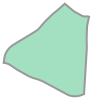

In [75]:
polygon1 = pna_urban['geometry'].loc['118']
polygon1

In [76]:
P1_area = polygon_area(polygon1)

In [77]:
# walk street network
P1_G_walk = ox.graph_from_polygon(polygon1, network_type='walk', truncate_by_edge=True, simplify=True)
# bike street network
P1_G_bike = ox.graph_from_polygon(polygon1, network_type='bike', truncate_by_edge=True, simplify=True)

In [78]:
P1_stats = stats_stnet(polygon1, P1_area, P1_G_walk, P1_G_bike)

/Users/1/mambaforge/envs/ppd599/lib/python3.10/site-packages/osmnx/simplification.py:458: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  merged = utils_graph.graph_to_gdfs(G, edges=False)["geometry"].buffer(tolerance).unary_union
/Users/1/mambaforge/envs/ppd599/lib/python3.10/site-packages/osmnx/simplification.py:437: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  return _merge_nodes_geometric(G, tolerance).centroid
/Users/1/mambaforge/envs/ppd599/lib/python3.10/site-packages/osmnx/simplification.py:458: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  merged = utils_graph.graph_

In [79]:
P1_stats

,Walk_stat,Bike_stat
n,3891.00,1682.00
m,12448.00,4016.00
k_avg,6.40,4.78
edge_length_total,576277.93,306271.02
edge_length_avg,46.29,76.26
streets_per_node_avg,3.25,2.88
intersection_count,3460.00,1394.00
street_length_total,288138.96,179600.66
street_segment_count,6224.00,2360.00
street_length_avg,46.29,76.10


### 3.2. Case Study Community 2 - Hollywood - North

In [80]:
hollywood_north

,Community,Acres,ParkAcres,Park_pct,AcresPer1000,Walkable_pct,Total_Pop,Pop_Density,Av_HouseSize,MedHouse_Income,...,Walking_Index,HispanicPct,WhitePct,Black_Pct,Asian_Pct,Am_Indian,Pac_Island,Other_Race,Multi_Race,geometry
STUD_AR_ID,,,,,,,,,,,,,,,,,,,,,
103,LA Hollywood - North,12826.1,4322.68,33.7,42.19,47.33,102455,7.99,1.82,70.164,...,103,18.99,61.65,4.43,10.56,0.21,0.09,0.32,3.75,"MULTIPOLYGON (((-118.28711 34.09817, -118.2874..."


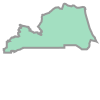

In [81]:
polygon2 = pna_urban['geometry'].loc['103']
polygon2

In [82]:
P2_area = polygon_area(polygon2)
P2_area

51884751.76628482

In [83]:
# walk street network
P2_G_walk = ox.graph_from_polygon(polygon2, network_type='walk', truncate_by_edge=True, simplify=True)
# bike street network
P2_G_bike = ox.graph_from_polygon(polygon2, network_type='bike', truncate_by_edge=True, simplify=True)

In [84]:
P2_stats = stats_stnet(polygon2, P2_area, P2_G_walk, P2_G_bike)

/Users/1/mambaforge/envs/ppd599/lib/python3.10/site-packages/osmnx/simplification.py:458: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  merged = utils_graph.graph_to_gdfs(G, edges=False)["geometry"].buffer(tolerance).unary_union
/Users/1/mambaforge/envs/ppd599/lib/python3.10/site-packages/osmnx/simplification.py:437: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  return _merge_nodes_geometric(G, tolerance).centroid
/Users/1/mambaforge/envs/ppd599/lib/python3.10/site-packages/osmnx/simplification.py:458: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  merged = utils_graph.graph_

In [85]:
P2_stats

,Walk_stat,Bike_stat
n,4959.00,3887.00
m,13200.00,9379.00
k_avg,5.32,4.83
edge_length_total,1342893.64,1009302.87
edge_length_avg,101.73,107.61
streets_per_node_avg,2.72,2.61
intersection_count,3948.00,2959.00
street_length_total,671446.82,525654.75
street_segment_count,6600.00,4954.00
street_length_avg,101.73,106.11


### 3.3. Case Study Community 3 - Hollywood - South

In [86]:
hollywood_south

,Community,Acres,ParkAcres,Park_pct,AcresPer1000,Walkable_pct,Total_Pop,Pop_Density,Av_HouseSize,MedHouse_Income,...,Walking_Index,HispanicPct,WhitePct,Black_Pct,Asian_Pct,Am_Indian,Pac_Island,Other_Race,Multi_Race,geometry
STUD_AR_ID,,,,,,,,,,,,,,,,,,,,,
104,LA Hollywood - South,3234.74,28.02,0.87,0.26,70.39,106236,32.84,2.3,49.524,...,97,47.72,33.93,3.36,12.19,0.14,0.09,0.33,2.25,"MULTIPOLYGON (((-118.28710 34.09817, -118.2851..."


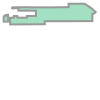

In [87]:
polygon3 = pna_urban['geometry'].loc['104']
polygon3

In [88]:
P3_area = polygon_area(polygon3)

In [89]:
# walk street network
P3_G_walk = ox.graph_from_polygon(polygon3, network_type='walk', truncate_by_edge=True, simplify=True)
# bike street network
P3_G_bike = ox.graph_from_polygon(polygon3, network_type='bike', truncate_by_edge=True, simplify=True)

In [90]:
P3_stats = stats_stnet(polygon3, P3_area, P3_G_walk, P3_G_bike)

/Users/1/mambaforge/envs/ppd599/lib/python3.10/site-packages/osmnx/simplification.py:458: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  merged = utils_graph.graph_to_gdfs(G, edges=False)["geometry"].buffer(tolerance).unary_union
/Users/1/mambaforge/envs/ppd599/lib/python3.10/site-packages/osmnx/simplification.py:437: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  return _merge_nodes_geometric(G, tolerance).centroid
/Users/1/mambaforge/envs/ppd599/lib/python3.10/site-packages/osmnx/simplification.py:458: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  merged = utils_graph.graph_

In [91]:
P3_stats

,Walk_stat,Bike_stat
n,3459.00,2682.00
m,10064.00,7133.00
k_avg,5.82,5.32
edge_length_total,625967.05,503372.18
edge_length_avg,62.20,70.57
streets_per_node_avg,3.00,2.86
intersection_count,2941.00,2222.00
street_length_total,312983.52,259125.32
street_segment_count,5032.00,3693.00
street_length_avg,62.20,70.17


### 3.4. Case Study Community 4 - Korea town

In [92]:
kt

,Community,Acres,ParkAcres,Park_pct,AcresPer1000,Walkable_pct,Total_Pop,Pop_Density,Av_HouseSize,MedHouse_Income,...,Walking_Index,HispanicPct,WhitePct,Black_Pct,Asian_Pct,Am_Indian,Pac_Island,Other_Race,Multi_Race,geometry
STUD_AR_ID,,,,,,,,,,,,,,,,,,,,,
068,LA Wilshire - Koreatown,2983.32,18.2,0.61,0.11,38.57,171372,57.44,2.62,39.759,...,91,52.66,5.6,3.79,36.31,0.1,0.05,0.25,1.25,"MULTIPOLYGON (((-118.31910 34.06173, -118.3178..."


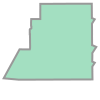

In [93]:
polygon4 = pna_urban['geometry'].loc['068']
polygon4

In [94]:
P4_area = polygon_area(polygon4)

In [95]:
# walk street network
P4_G_walk = ox.graph_from_polygon(polygon4, network_type='walk', truncate_by_edge=True, simplify=True)
# bike street network
P4_G_bike = ox.graph_from_polygon(polygon4, network_type='bike', truncate_by_edge=True, simplify=True)

In [96]:
P4_stats = stats_stnet(polygon4, P4_area, P4_G_walk, P4_G_bike)

/Users/1/mambaforge/envs/ppd599/lib/python3.10/site-packages/osmnx/simplification.py:458: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  merged = utils_graph.graph_to_gdfs(G, edges=False)["geometry"].buffer(tolerance).unary_union
/Users/1/mambaforge/envs/ppd599/lib/python3.10/site-packages/osmnx/simplification.py:437: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  return _merge_nodes_geometric(G, tolerance).centroid
/Users/1/mambaforge/envs/ppd599/lib/python3.10/site-packages/osmnx/simplification.py:458: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  merged = utils_graph.graph_

In [97]:
P4_stats

,Walk_stat,Bike_stat
n,3412.00,2190.00
m,10552.00,5901.00
k_avg,6.19,5.39
edge_length_total,604789.93,441899.71
edge_length_avg,57.32,74.89
streets_per_node_avg,3.16,2.89
intersection_count,3012.00,1850.00
street_length_total,302394.97,228461.75
street_segment_count,5276.00,3078.00
street_length_avg,57.32,74.22


### 3.5. Case Study Community 5 - Culver City

In [98]:
culver_city

,Community,Acres,ParkAcres,Park_pct,AcresPer1000,Walkable_pct,Total_Pop,Pop_Density,Av_HouseSize,MedHouse_Income,...,Walking_Index,HispanicPct,WhitePct,Black_Pct,Asian_Pct,Am_Indian,Pac_Island,Other_Race,Multi_Race,geometry
STUD_AR_ID,,,,,,,,,,,,,,,,,,,,,
172,Culver City,3286.18,497.89,15.15,12.59,71.0,39557,12.04,2.32,101.186,...,115,25.22,43.62,8.78,16.58,0.16,0.19,0.54,4.92,"MULTIPOLYGON (((-118.37158 34.03067, -118.3718..."


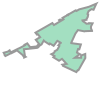

In [99]:
polygon5 = pna_urban['geometry'].loc['172']
polygon5

In [100]:
P5_area = polygon_area(polygon5)

In [101]:
# walk street network
P5_G_walk = ox.graph_from_polygon(polygon5, network_type='walk', truncate_by_edge=True, simplify=True)
# bike street network
P5_G_bike = ox.graph_from_polygon(polygon5, network_type='bike', truncate_by_edge=True, simplify=True)

In [102]:
P5_stats = stats_stnet(polygon5, P5_area, P5_G_walk, P5_G_bike)

/Users/1/mambaforge/envs/ppd599/lib/python3.10/site-packages/osmnx/simplification.py:458: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  merged = utils_graph.graph_to_gdfs(G, edges=False)["geometry"].buffer(tolerance).unary_union
/Users/1/mambaforge/envs/ppd599/lib/python3.10/site-packages/osmnx/simplification.py:437: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  return _merge_nodes_geometric(G, tolerance).centroid
/Users/1/mambaforge/envs/ppd599/lib/python3.10/site-packages/osmnx/simplification.py:458: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  merged = utils_graph.graph_

In [103]:
P5_stats

,Walk_stat,Bike_stat
n,5277.00,3211.00
m,16128.00,8146.00
k_avg,6.11,5.07
edge_length_total,776865.54,541184.49
edge_length_avg,48.17,66.44
streets_per_node_avg,3.13,2.87
intersection_count,4722.00,2725.00
street_length_total,388432.77,296685.54
street_segment_count,8064.00,4487.00
street_length_avg,48.17,66.12


### 3.6. Case Study Community 6 - LA San Pedro - Port of LA

In [104]:
la_port

,Community,Acres,ParkAcres,Park_pct,AcresPer1000,Walkable_pct,Total_Pop,Pop_Density,Av_HouseSize,MedHouse_Income,...,Walking_Index,HispanicPct,WhitePct,Black_Pct,Asian_Pct,Am_Indian,Pac_Island,Other_Race,Multi_Race,geometry
STUD_AR_ID,,,,,,,,,,,,,,,,,,,,,
185,LA San Pedro / LA Port of Los Angeles / La Rambla,8333.63,726.0,8.71,8.81,88.96,82431,9.89,2.58,70.935,...,101,49.16,35.29,5.65,5.76,0.32,0.35,0.24,3.22,"MULTIPOLYGON (((-118.26739 33.70366, -118.2674..."


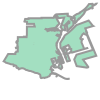

In [105]:
polygon6 = pna_urban['geometry'].loc['185']
polygon6

In [106]:
P6_area = polygon_area(polygon6)

In [107]:
# walk street network
P6_G_walk = ox.graph_from_polygon(polygon6, network_type='walk', truncate_by_edge=True, simplify=True)
# bike street network
P6_G_bike = ox.graph_from_polygon(polygon6, network_type='bike', truncate_by_edge=True, simplify=True)

In [108]:
P6_stats = stats_stnet(polygon6, P6_area, P6_G_walk, P6_G_bike)

/Users/1/mambaforge/envs/ppd599/lib/python3.10/site-packages/osmnx/simplification.py:458: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  merged = utils_graph.graph_to_gdfs(G, edges=False)["geometry"].buffer(tolerance).unary_union
/Users/1/mambaforge/envs/ppd599/lib/python3.10/site-packages/osmnx/simplification.py:437: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  return _merge_nodes_geometric(G, tolerance).centroid
/Users/1/mambaforge/envs/ppd599/lib/python3.10/site-packages/osmnx/simplification.py:458: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  merged = utils_graph.graph_

In [109]:
P6_stats

,Walk_stat,Bike_stat
n,3874.00,3512.00
m,11318.00,9812.00
k_avg,5.84,5.59
edge_length_total,874235.06,770943.37
edge_length_avg,77.24,78.57
streets_per_node_avg,2.94,2.93
intersection_count,3322.00,3019.00
street_length_total,437117.53,404916.56
street_segment_count,5659.00,5121.00
street_length_avg,77.24,79.07


### 3.7. Merge all data of street network stats

In [110]:
# merge all DataFrames
df_merged_1 = pd.merge(left=P1_stats, right=P2_stats, how='inner', left_index=True, right_index=True) 
df_merged_2 = pd.merge(left=df_merged_1, right=P3_stats, how='inner', left_index=True, right_index=True)
df_merged_3 = pd.merge(left=df_merged_2, right=P4_stats, how='inner', left_index=True, right_index=True)
df_merged_4 = pd.merge(left=df_merged_3, right=P5_stats, how='inner', left_index=True, right_index=True)
df_merged_ALL = pd.merge(left=df_merged_4, right=P6_stats, how='inner', left_index=True, right_index=True)
df_merged_ALL

/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/2317136188.py:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'Walk_stat_x', 'Bike_stat_x'} in the result is deprecated and will raise a MergeError in a future version.
  df_merged_3 = pd.merge(left=df_merged_2, right=P4_stats, how='inner', left_index=True, right_index=True)
/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/2317136188.py:6: FutureWarning: Passing 'suffixes' which cause duplicate columns {'Walk_stat_x', 'Bike_stat_x'} in the result is deprecated and will raise a MergeError in a future version.
  df_merged_ALL = pd.merge(left=df_merged_4, right=P6_stats, how='inner', left_index=True, right_index=True)


,Walk_stat_x,Bike_stat_x,Walk_stat_y,Bike_stat_y,Walk_stat_x,Bike_stat_x,Walk_stat_y,Bike_stat_y,Walk_stat_x,Bike_stat_x,Walk_stat_y,Bike_stat_y
n,3891.00,1682.00,4959.00,3887.00,3459.00,2682.00,3412.00,2190.00,5277.00,3211.00,3874.00,3512.00
m,12448.00,4016.00,13200.00,9379.00,10064.00,7133.00,10552.00,5901.00,16128.00,8146.00,11318.00,9812.00
k_avg,6.40,4.78,5.32,4.83,5.82,5.32,6.19,5.39,6.11,5.07,5.84,5.59
edge_length_total,576277.93,306271.02,1342893.64,1009302.87,625967.05,503372.18,604789.93,441899.71,776865.54,541184.49,874235.06,770943.37
edge_length_avg,46.29,76.26,101.73,107.61,62.20,70.57,57.32,74.89,48.17,66.44,77.24,78.57
streets_per_node_avg,3.25,2.88,2.72,2.61,3.00,2.86,3.16,2.89,3.13,2.87,2.94,2.93
intersection_count,3460.00,1394.00,3948.00,2959.00,2941.00,2222.00,3012.00,1850.00,4722.00,2725.00,3322.00,3019.00
street_length_total,288138.96,179600.66,671446.82,525654.75,312983.52,259125.32,302394.97,228461.75,388432.77,296685.54,437117.53,404916.56
street_segment_count,6224.00,2360.00,6600.00,4954.00,5032.00,3693.00,5276.00,3078.00,8064.00,4487.00,5659.00,5121.00
street_length_avg,46.29,76.10,101.73,106.11,62.20,70.17,57.32,74.22,48.17,66.12,77.24,79.07


- The highest street density is in Downtown and Culver City. 
- The lowest street density is in Hollywood - North. 
- Hollywood - North and Hollywood - South values of interest variables vary significantly. 

## 4. Accessibility Analysis of Study Areas

#### Functions for Green Space Accessibility Analysis

In [111]:
# add walking and bicycling time and speeds limits
walk_time = 15 # max time walking in minutes
walk_speed = 4.5 # km/h
bike_time = 15 # max time bicycling in minutes
bike_speed = 30 # km/h
max_items = 4

In [112]:
# function for accesibility map 
def access_map(polygon, G, speed=4.5, time=15, maxitems=2, num_pois=2, place='place'):
    
    # tags for green public spaces extraction form OSM
    tags = {'leisure' : ['park', 'garden', 'nature_reserve']}
    gdf_parks = ox.geometries_from_polygon(polygon, tags)
    
    # add the walking speed to every edge
    for u, v, data in G.edges(data=True):
        data['speed_kph'] = speed
    
    G = ox.add_edge_travel_times(G)
        
    # nodes and ages of gdf for pandana
    nodes = ox.graph_to_gdfs(G, edges=False)[['x', 'y']]
    edges = ox.graph_to_gdfs(G, nodes=False).reset_index()[['u', 'v', 'travel_time']]
        
    # create pandana network  
    network = pandana.Network(node_x=nodes['x'],
                              node_y=nodes['y'], 
                              edge_from=edges['u'],
                              edge_to=edges['v'],
                              edge_weights=edges[['travel_time']])
        
    # extract centroids from the parks' geometries
    centroids = gdf_parks.centroid
        
    # then set the parks' locations on the network
    maxdist_w = time * 60
    network.set_pois(category='park',
                       maxdist=maxdist_w,
                       maxitems=maxitems,
                       x_col=centroids.x, 
                       y_col=centroids.y)
        
    # calculation of travel time to nearest park from each node in network
    distances_w = network.nearest_pois(distance=maxdist_w,
                                       category='park',
                                       num_pois=num_pois)
    # convert distances to integers 
    distances_w = distances_w.astype(int)
    
    # plot distance to nearest park
    fig, ax = plt.subplots(figsize=(6, 6), dpi=600, facecolor='none')
    ax.set_facecolor('none')
    ax.grid(False)
    
    # plot parks and distances
    fig, ax = ox.plot_footprints(gdf_parks,  ax=ax, color='lime', alpha=0.9, 
                                 show=False)
    fig, ax = ox.plot_graph(G, ax=ax, node_size=0.4, edge_linewidth=0.1,
                            edge_color='gray', show=False, close=False)
    
    # plot scatter    
    sc = ax.scatter(x=nodes['x'],
                    y=nodes['y'], 
                    c=distances_w[1],
                    s=1,
                    cmap='inferno_r') #inferno_r
        
    # ax.set_title(f'Time to nearest park')
    plt.colorbar(sc, shrink=0.5).outline.set_edgecolor('none')
    
    # save file in png format
    fig.patch.set_alpha(0)
    plt.savefig(f'images/{place}TimeToNearestPark.png', dpi=900, bbox_inches='tight')

In [113]:
# function for the best nodes with close to up tp 3 parks
def park_count(polygon, G, speed=4.5, time=15, maxitems=3, place='place'):
    
    # tags for green public spaces extraction form OSM
    tags = {'leisure' : ['park', 'garden', 'nature_reserve']}
    gdf_parks = ox.geometries_from_polygon(polygon, tags)
    
    # extract centroids from the parks' geometries
    centroids = gdf_parks.centroid
    
    # add the walking speed to every edge
    for u, v, data in G.edges(data=True):
        data['speed_kph'] = speed
    
    G = ox.add_edge_travel_times(G)
        
    # nodes and ages of gdf for pandana
    nodes = ox.graph_to_gdfs(G, edges=False)[['x', 'y']]
    edges = ox.graph_to_gdfs(G, nodes=False).reset_index()[['u', 'v', 'travel_time']]
        
    # create pandana network  
    network = pandana.Network(node_x=nodes['x'],
                              node_y=nodes['y'], 
                              edge_from=edges['u'],
                              edge_to=edges['v'],
                              edge_weights=edges[['travel_time']])
    
    # then set the parks' locations on the network
    maxdist = time * 60
    network.set_pois(category='park',
                       maxdist=maxdist,
                       maxitems=maxitems,
                       x_col=centroids.x, 
                       y_col=centroids.y)
    
    # park to the network nodes
    node_ids = network.get_node_ids(centroids.x, centroids.y)
    network.set(node_ids, name='park')
    
    # assign the varuable to nodes
    access = network.aggregate(distance=maxdist,
                               type='count',
                               decay='linear',
                               name='park')
    # max three parks access
    access = access.clip(upper=3)
    
    # plot parks count within the set walking limit
    fig, ax = ox.plot_footprints(gdf_parks, color='lime', alpha=0.8,  show=False)
    fig, ax = ox.plot_graph(G, ax=ax, node_size=0, edge_linewidth=0.1,
                            edge_color='gray', show=False, close=False)
    
    sc = ax.scatter(x=nodes['x'],
                    y=nodes['y'], 
                    c=access,
                    s=1,
                    cmap='viridis')
    
    plt.colorbar(sc, shrink=0.5).outline.set_edgecolor('none')
    
    # save file in png format
    fig.patch.set_alpha(0)
    plt.savefig(f'images/{place}ParkCountWithin15min.png', dpi=900, bbox_inches='tight')

    return access.describe()

In [114]:
# create function for OSM park count
def park_place_gdf(polygon):
    tags = {'leisure' : ['park', 'garden']}
    gdf_parks = ox.geometries_from_polygon(polygon, tags)
    return gdf_parks.shape

In [115]:
# create a function for park count density 
def park_count_density(polygon, park_count):
    polygon_transformed = transform(transformer.transform, polygon)
    # Calculate the area in ^m
    area = polygon_transformed.area 
    
    park_count_dens = park_count / (area/ 1e+6) # park count per ^km
    
    return print(f'{park_count_dens} per ^km')

#### Place 1 - Downtown

In [116]:
park_place_gdf(polygon1)

(53, 32)

In [117]:
park_count_density(polygon1, 53)

5.862796932425345 per ^km


/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/1143164197.py:26: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = gdf_parks.centroid


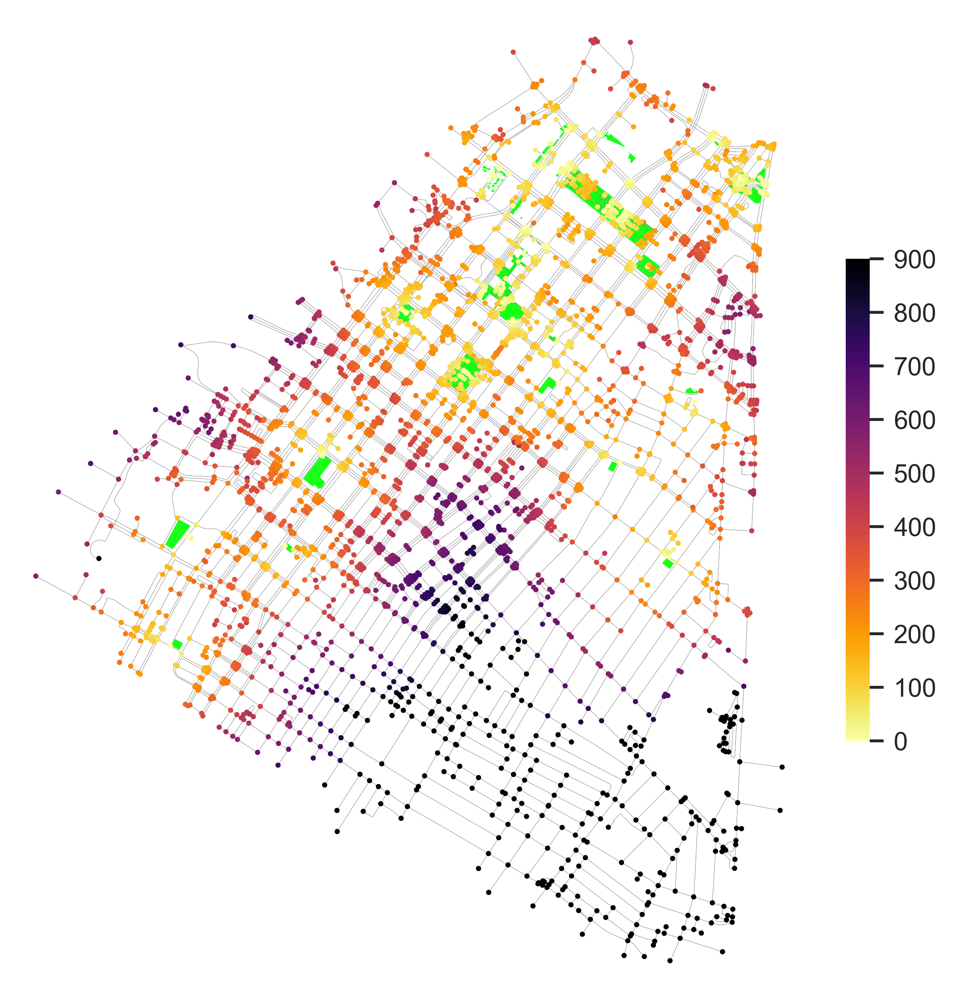

In [118]:
# map walking access to park  
access_map(polygon1, P1_G_walk, speed=walk_speed, time=walk_time, maxitems=3, num_pois=3, place='dtla_w')

/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/1143164197.py:26: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = gdf_parks.centroid


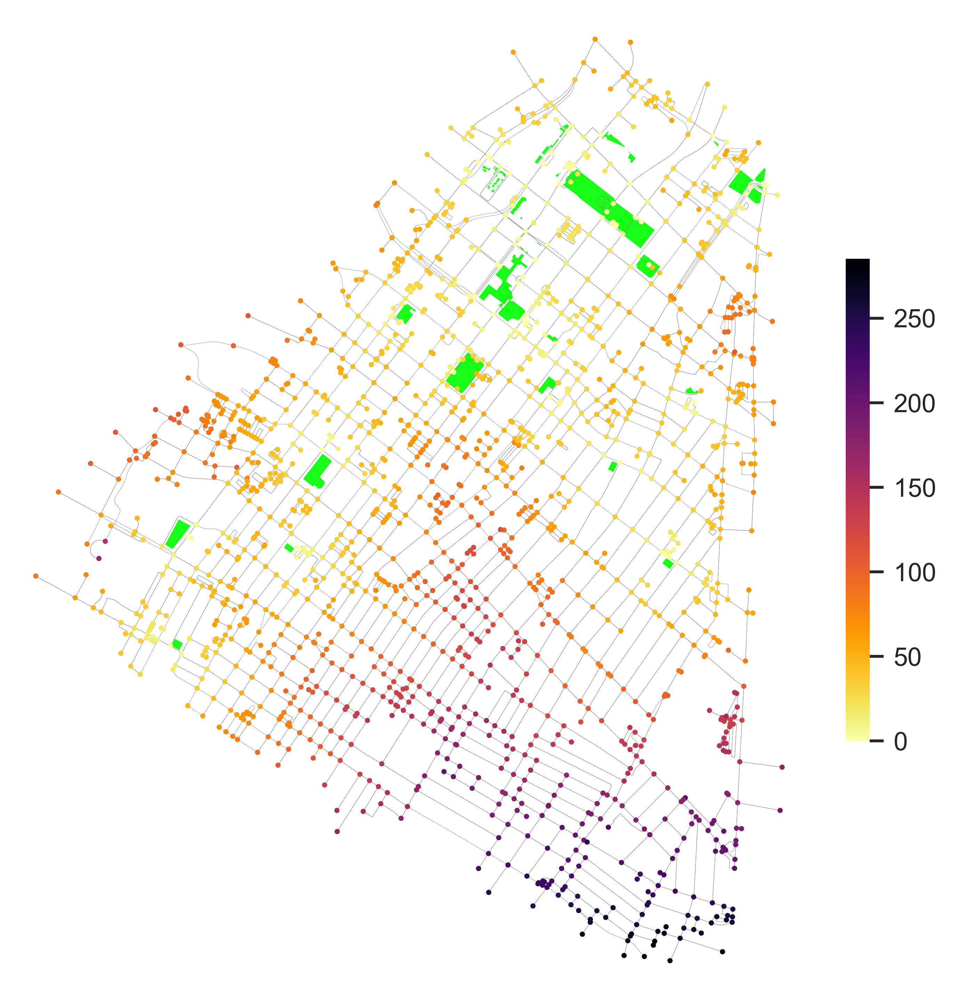

In [119]:
# map bicycling access to park 
access_map(polygon1, P1_G_bike, speed=bike_speed, time=bike_time, maxitems=3, num_pois=3, place='dtla_b')

/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/1970316460.py:9: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = gdf_parks.centroid


count    3891.000000
mean        2.668466
std         0.827907
min         0.000000
25%         3.000000
50%         3.000000
75%         3.000000
max         3.000000
dtype: float64

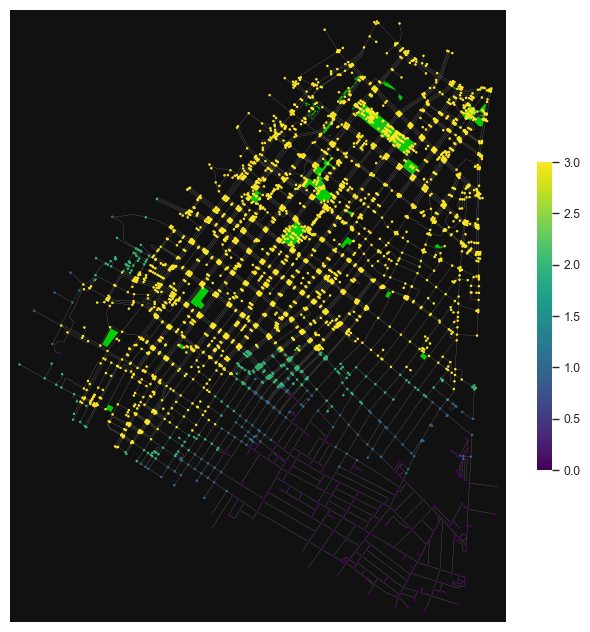

In [120]:
# count and plot parks count within 15 minutes walk distance
park_count(polygon1, P1_G_walk, speed=walk_speed, time=walk_time, maxitems=max_items, place='dtla_pc_w')

/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/1970316460.py:9: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = gdf_parks.centroid


count    1682.0
mean        3.0
std         0.0
min         3.0
25%         3.0
50%         3.0
75%         3.0
max         3.0
dtype: float64

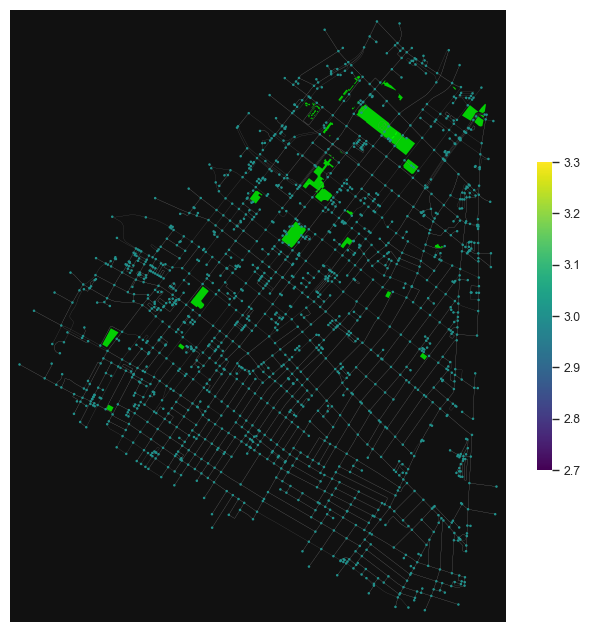

In [121]:
park_count(polygon1, P1_G_bike, speed=bike_speed, time=bike_time, maxitems=max_items, place='dtla_pc_b')

#### Place 2 - Hollywood - North

In [122]:
park_place_gdf(polygon2)

(27, 26)

In [123]:
park_count_density(polygon2, 27)

0.5203841028597701 per ^km


/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/1143164197.py:26: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = gdf_parks.centroid


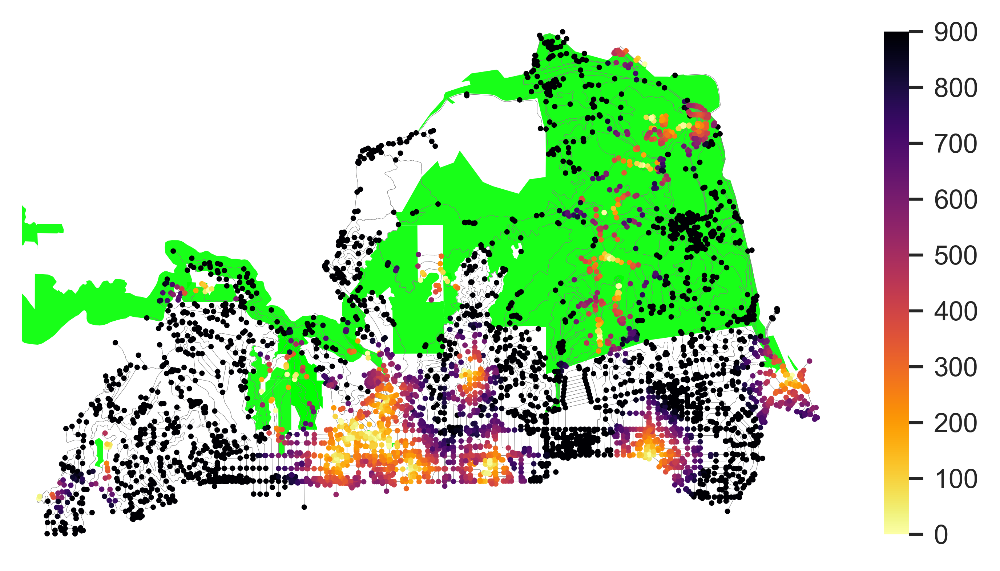

In [124]:
# map walking access to park  
access_map(polygon2, P2_G_walk, speed=walk_speed, time=walk_time, maxitems=max_items, num_pois=3, place='hol_north_w')

/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/1143164197.py:26: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = gdf_parks.centroid


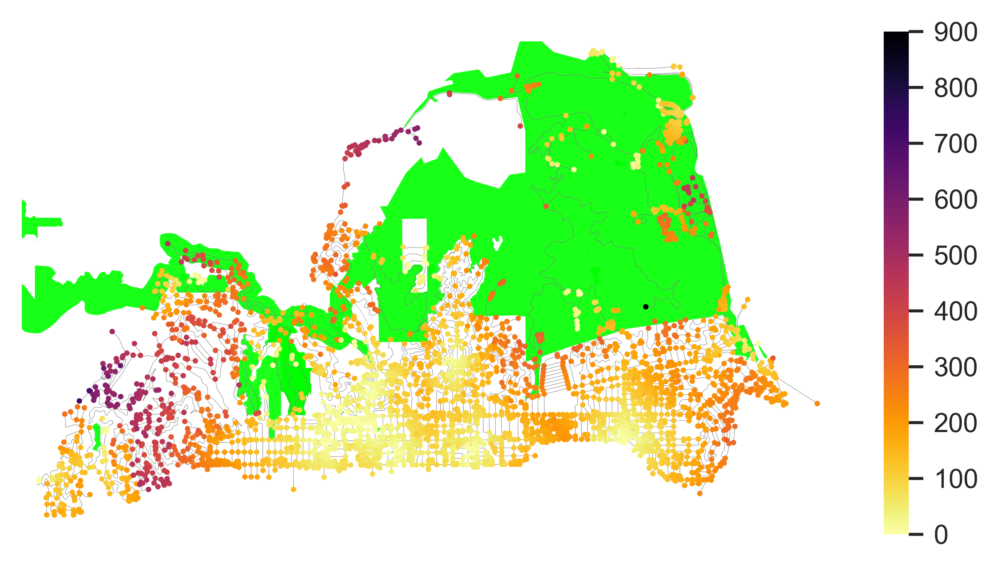

In [125]:
# map bicycling access to park 
access_map(polygon2, P2_G_bike, speed=bike_speed, time=bike_time, maxitems=3, num_pois=3, place='hol_north_b')

/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/1970316460.py:9: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = gdf_parks.centroid


count    4959.000000
mean        1.061303
std         1.148105
min         0.000000
25%         0.000000
50%         1.000000
75%         2.000000
max         3.000000
dtype: float64

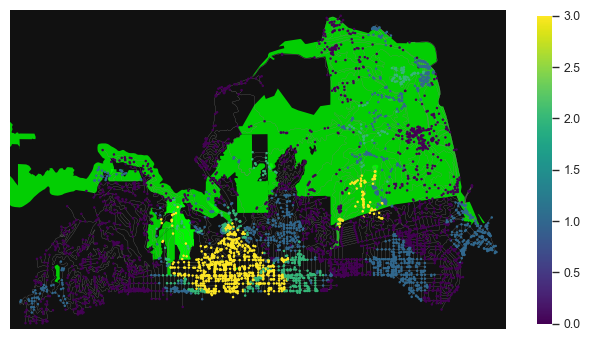

In [126]:
park_count(polygon2, P2_G_walk, speed=walk_speed, time=walk_time, maxitems=max_items, place='hol_north_pc_w')

/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/1970316460.py:9: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = gdf_parks.centroid


count    3887.000000
mean        2.981477
std         0.140459
min         0.000000
25%         3.000000
50%         3.000000
75%         3.000000
max         3.000000
dtype: float64

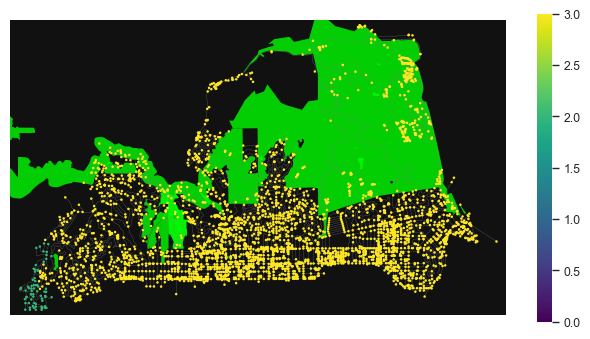

In [127]:
park_count(polygon2, P2_G_bike, speed=bike_speed, time=bike_time, maxitems=max_items, place='hol_north_pc_b')

#### Place 3 - Hollywood - South

In [128]:
park_place_gdf(polygon3)

(20, 23)

In [129]:
park_count_density(polygon3, 20)

1.528444358082767 per ^km


/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/1143164197.py:26: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = gdf_parks.centroid


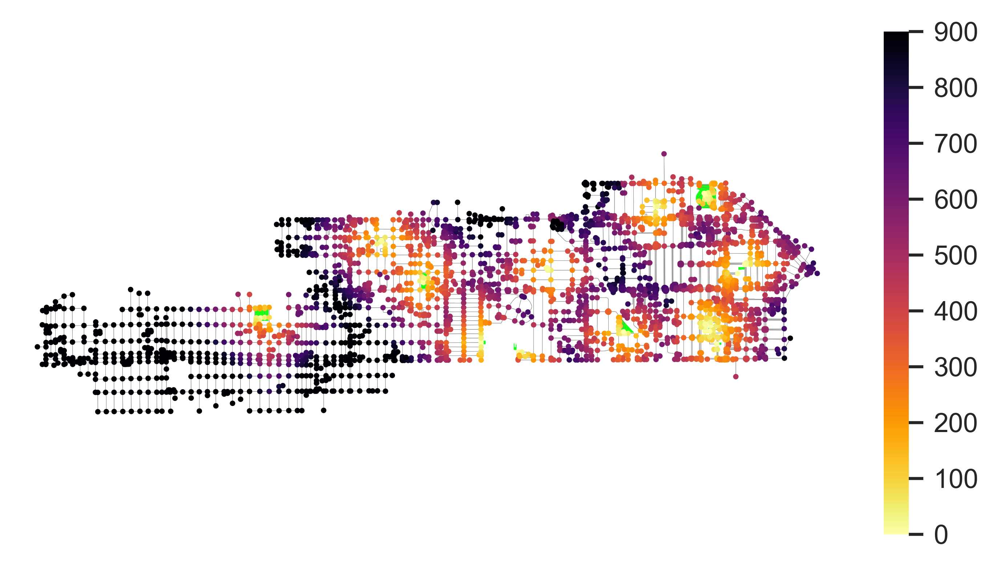

In [130]:
# map walking access to park  
access_map(polygon3, P3_G_walk, speed=walk_speed, time=walk_time, maxitems=3, num_pois=3, place='hol_south_w')

/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/1143164197.py:26: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = gdf_parks.centroid


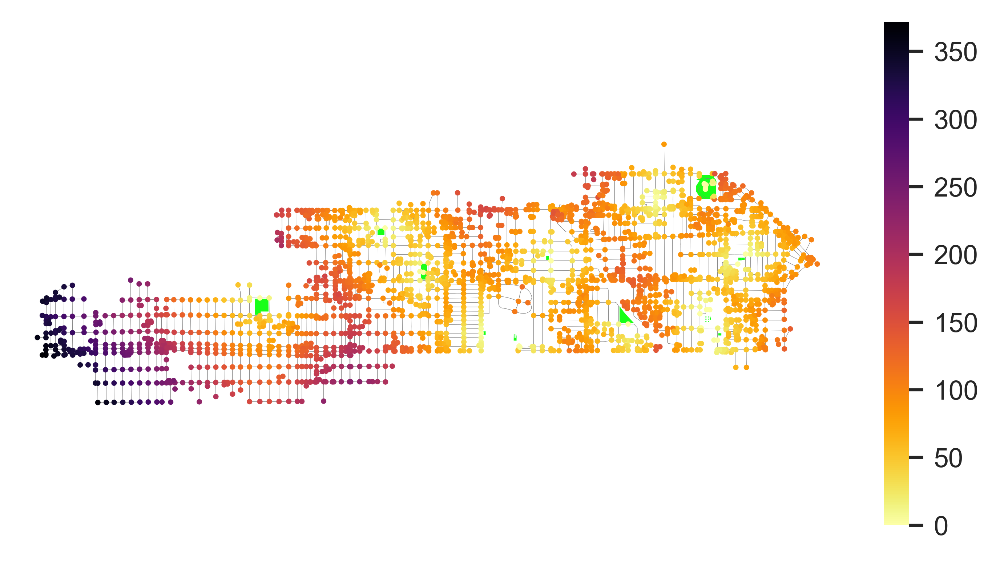

In [131]:
# map bicycling access to park 
access_map(polygon3, P3_G_bike, speed=bike_speed, time=bike_time, maxitems=3, num_pois=3, place='hol_south_b')

/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/1970316460.py:9: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = gdf_parks.centroid


count    3459.000000
mean        1.844753
std         1.089892
min         0.000000
25%         1.000000
50%         2.000000
75%         3.000000
max         3.000000
dtype: float64

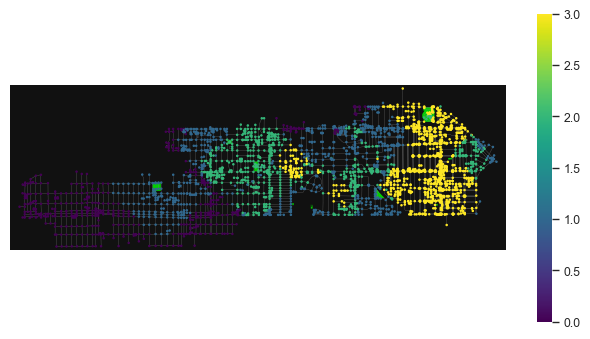

In [132]:
park_count(polygon3, P3_G_walk, speed=walk_speed, time=walk_time, maxitems=max_items, place='hol_south_pc_w')

/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/1970316460.py:9: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = gdf_parks.centroid


count    2682.0
mean        3.0
std         0.0
min         3.0
25%         3.0
50%         3.0
75%         3.0
max         3.0
dtype: float64

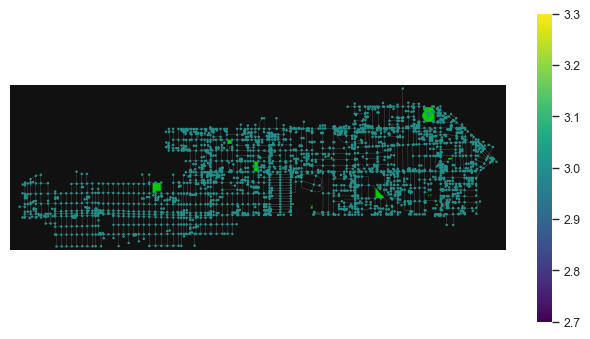

In [133]:
park_count(polygon3, P3_G_bike, speed=bike_speed, time=bike_time, maxitems=max_items, place='hol_south_pc_b')

#### Place 4 - Korea town

In [134]:
park_place_gdf(polygon4)

(18, 14)

In [135]:
park_count_density(polygon4, 18)

1.4915668166041878 per ^km


/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/1143164197.py:26: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = gdf_parks.centroid


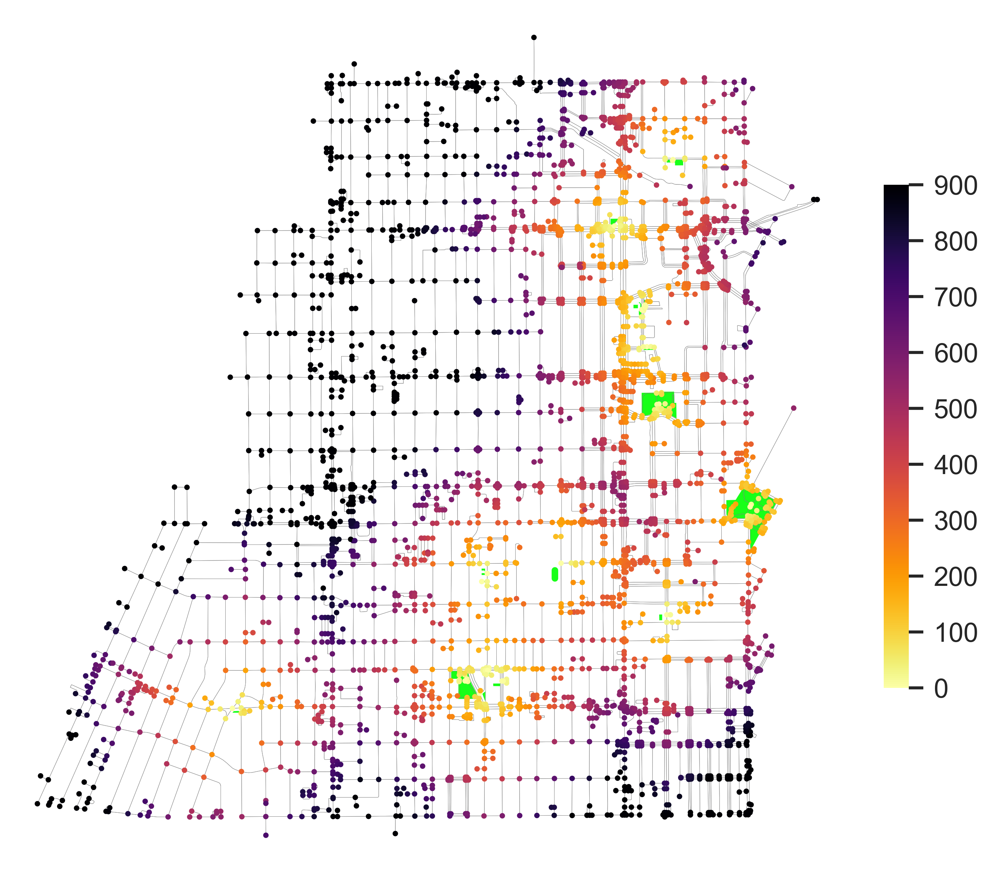

In [136]:
# map walking access to park  
access_map(polygon4, P4_G_walk, speed=walk_speed, time=walk_time, maxitems=3, num_pois=3, place='kt_w')

/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/1143164197.py:26: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = gdf_parks.centroid


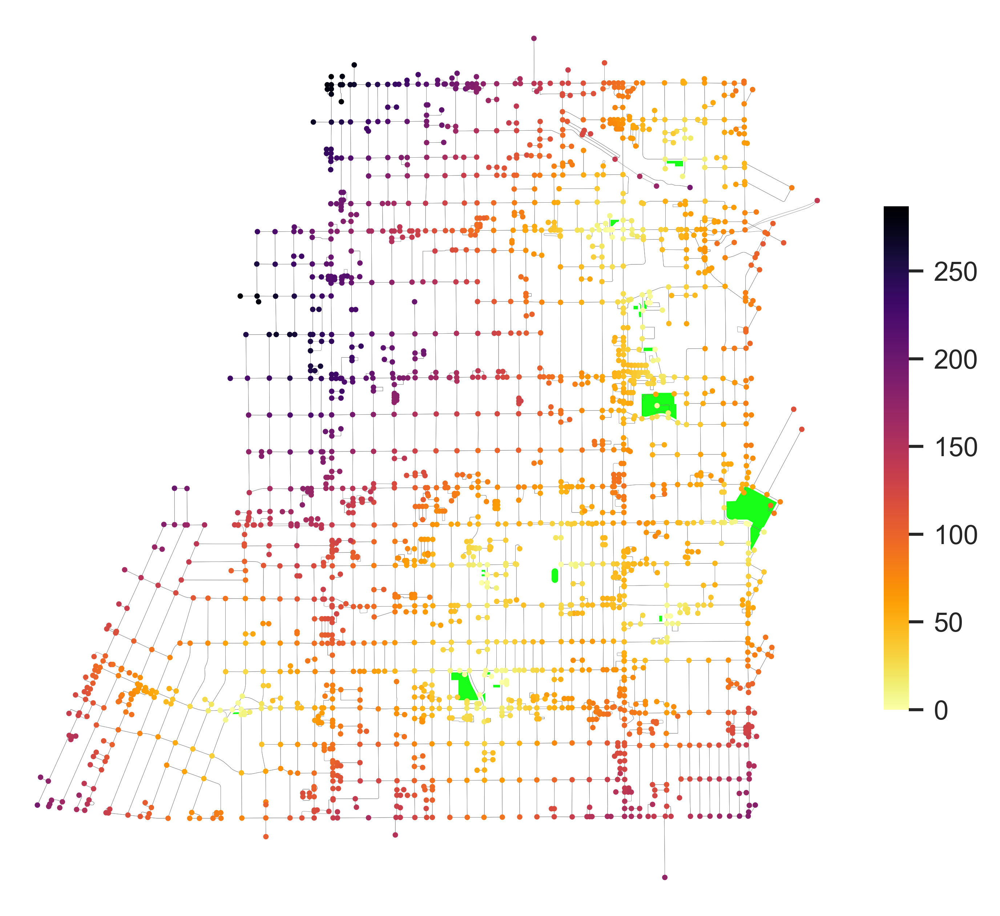

In [137]:
# map bicycling access to park 
access_map(polygon4, P4_G_bike, speed=bike_speed, time=bike_time, maxitems=3, num_pois=3, place='kt_b')

/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/1970316460.py:9: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = gdf_parks.centroid


count    3412.000000
mean        2.131008
std         1.156786
min         0.000000
25%         1.000000
50%         3.000000
75%         3.000000
max         3.000000
dtype: float64

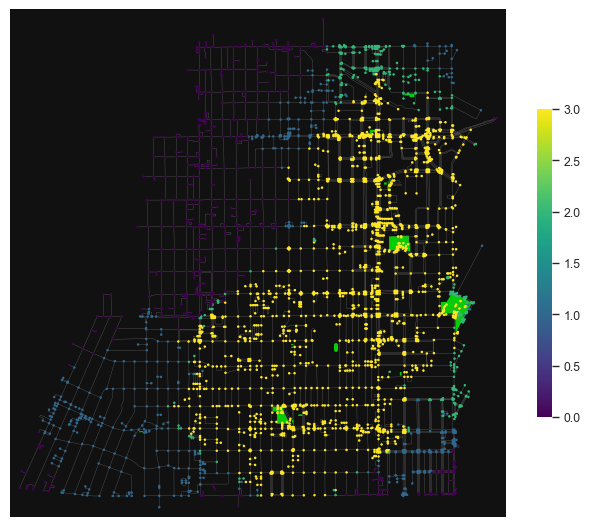

In [138]:
park_count(polygon4, P4_G_walk, speed=walk_speed, time=walk_time, maxitems=max_items, place='kt_pc_w')

/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/1970316460.py:9: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = gdf_parks.centroid


count    2190.0
mean        3.0
std         0.0
min         3.0
25%         3.0
50%         3.0
75%         3.0
max         3.0
dtype: float64

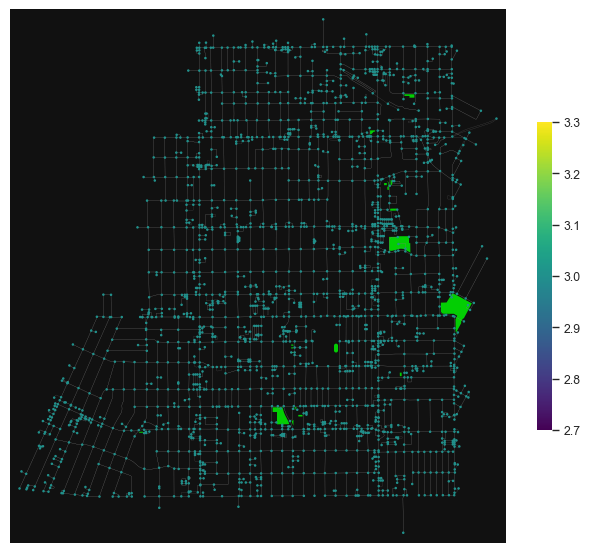

In [139]:
park_count(polygon4, P4_G_bike, speed=bike_speed, time=bike_time, maxitems=max_items, place='kt_pc_b')

#### Place 5 - Culver City

In [140]:
park_place_gdf(polygon5)

(24, 24)

In [141]:
park_count_density(polygon1, 24)

2.6548514410982693 per ^km


/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/1143164197.py:26: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = gdf_parks.centroid


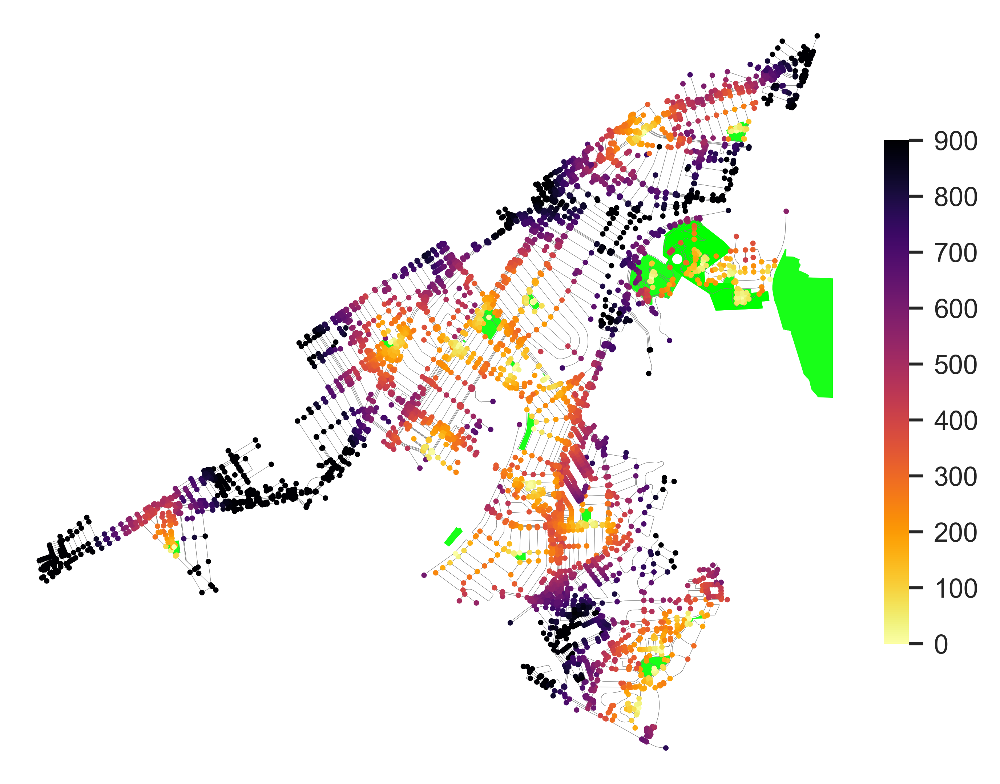

In [142]:
# map walking access to park  
access_map(polygon5, P5_G_walk, speed=walk_speed, time=walk_time, maxitems=3, num_pois=3, place='culcity_w')

/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/1143164197.py:26: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = gdf_parks.centroid


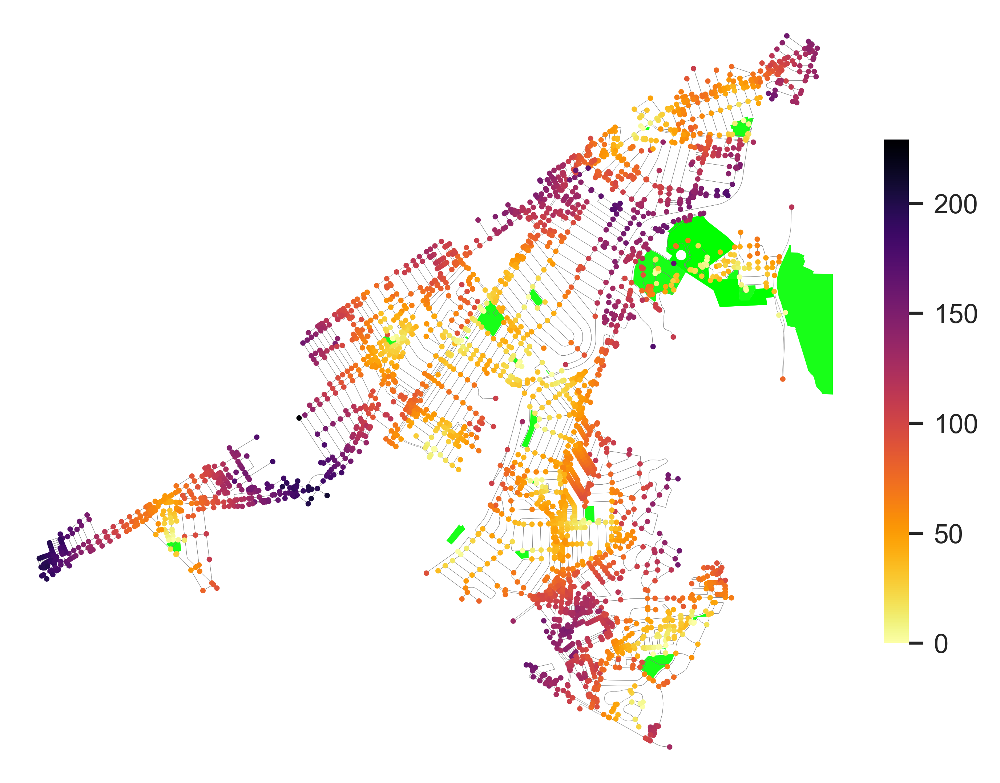

In [143]:
# map bicycling access to park 
access_map(polygon5, P5_G_bike, speed=bike_speed, time=bike_time, maxitems=3, num_pois=3, place='culcity_b')

/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/1970316460.py:9: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = gdf_parks.centroid


count    5277.000000
mean        1.839113
std         1.086516
min         0.000000
25%         1.000000
50%         2.000000
75%         3.000000
max         3.000000
dtype: float64

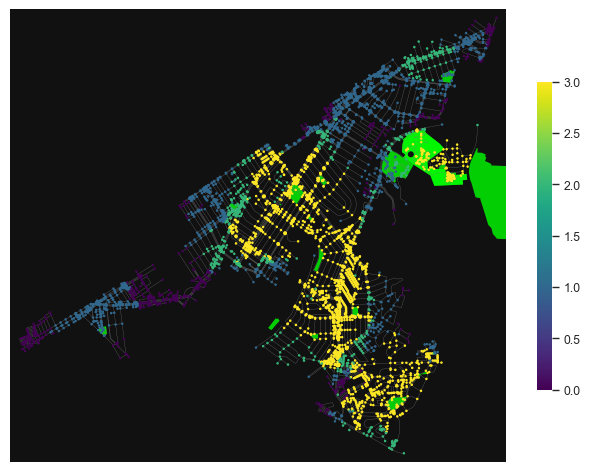

In [144]:
park_count(polygon5, P5_G_walk, speed=walk_speed, time=walk_time, maxitems=max_items, place='culcit_pc_w')

/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/1970316460.py:9: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = gdf_parks.centroid


count    3211.0
mean        3.0
std         0.0
min         3.0
25%         3.0
50%         3.0
75%         3.0
max         3.0
dtype: float64

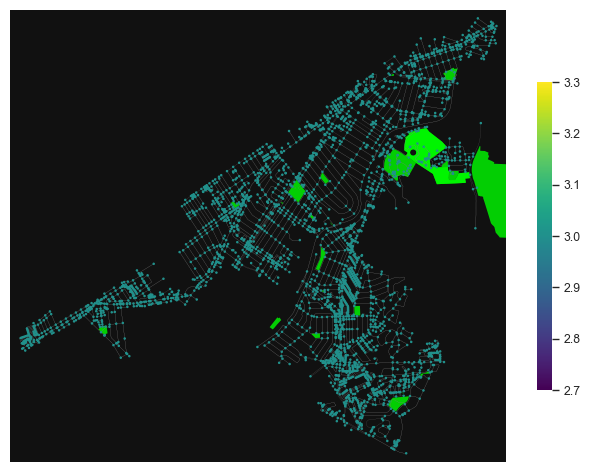

In [145]:
park_count(polygon5, P5_G_bike, speed=bike_speed, time=bike_time, maxitems=max_items, place='culcit_pc_b')

#### Place 6 - LA San Pedro - Port of LA

In [146]:
park_place_gdf(polygon6)

(47, 25)

In [147]:
park_count_density(polygon6, 47)

1.3944661897254096 per ^km


/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/1143164197.py:26: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = gdf_parks.centroid


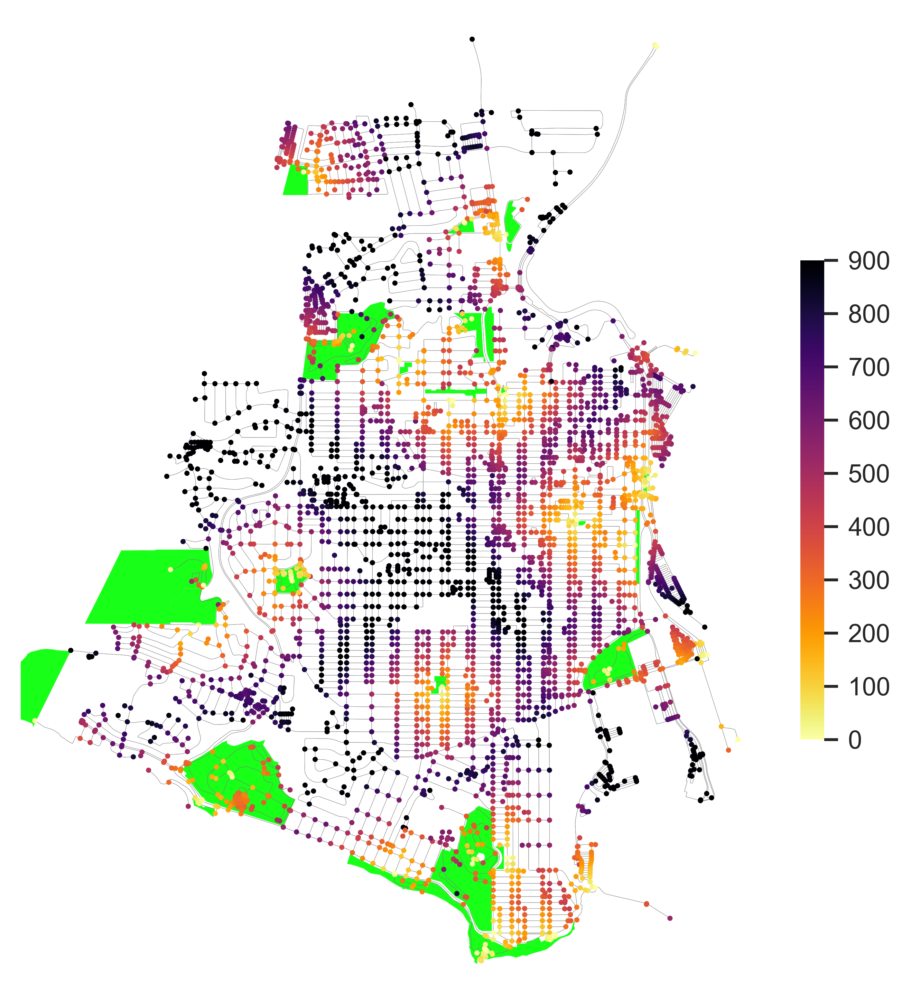

In [148]:
# map walking access to park  
access_map(polygon6, P6_G_walk, speed=walk_speed, time=walk_time, maxitems=3, num_pois=3, place='portla_w')

/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/1143164197.py:26: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = gdf_parks.centroid


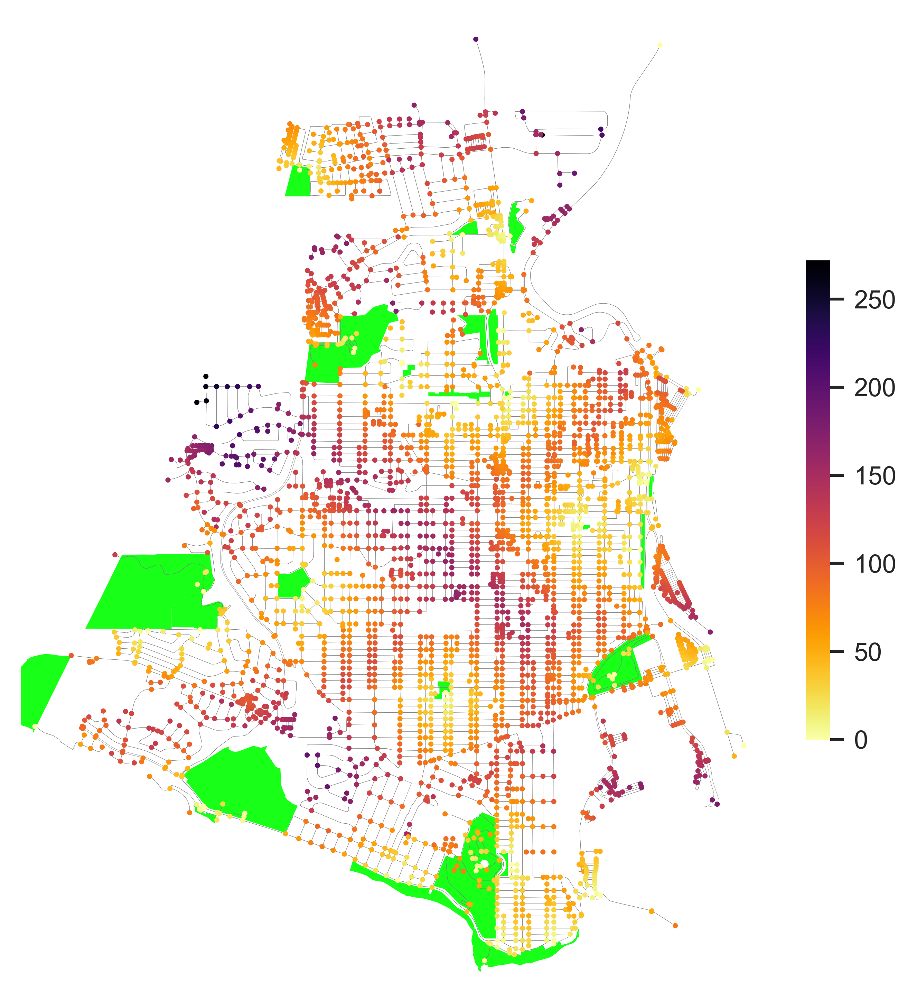

In [149]:
# map bicycling access to park 
access_map(polygon6, P6_G_bike, speed=bike_speed, time=bike_time, maxitems=3, num_pois=3, place='portla_b')

/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/1970316460.py:9: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = gdf_parks.centroid


count    3874.000000
mean        1.763036
std         1.084652
min         0.000000
25%         1.000000
50%         2.000000
75%         3.000000
max         3.000000
dtype: float64

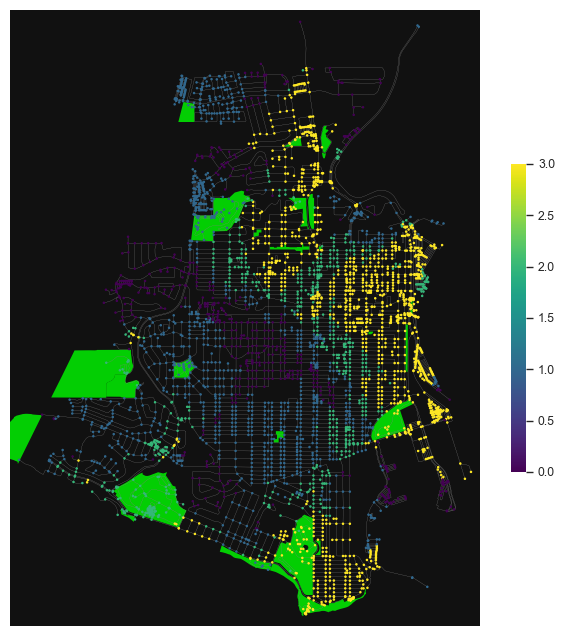

In [150]:
park_count(polygon6, P6_G_walk, speed=walk_speed, time=walk_time, maxitems=max_items, place='portla_pc_w')

/var/folders/ln/ymm2gs4d6mn84hbylb8r0pqr0000gn/T/ipykernel_2278/1970316460.py:9: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = gdf_parks.centroid


count    3512.0
mean        3.0
std         0.0
min         3.0
25%         3.0
50%         3.0
75%         3.0
max         3.0
dtype: float64

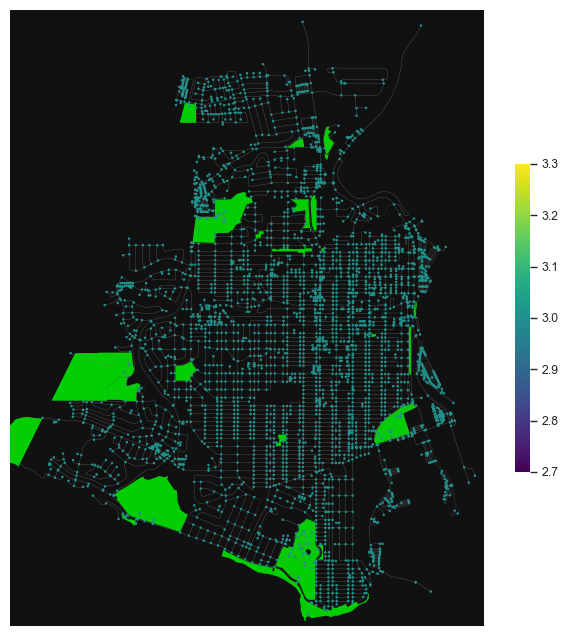

In [151]:
park_count(polygon6, P6_G_bike, speed=bike_speed, time=bike_time, maxitems=max_items, place='portla_pc_b')

## 5. Machine Learning. Clustering Analysis

Clustering analysis aims to identify grouping of walkable access in dependes from park characteristics and socioeconomic factors.

In [152]:
from scipy.cluster import hierarchy
from scipy.spatial.distance import pdist
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

np.random.seed(0)

In [153]:
pna_urban.columns

Index(['Community', 'Acres', 'ParkAcres', 'Park_pct', 'AcresPer1000',
       'Walkable_pct', 'Total_Pop', 'Pop_Density', 'Av_HouseSize',
       'MedHouse_Income', 'Bicycling_Index', 'Walking_Index', 'HispanicPct',
       'WhitePct', 'Black_Pct', 'Asian_Pct', 'Am_Indian', 'Pac_Island',
       'Other_Race', 'Multi_Race', 'geometry'],
      dtype='object')

In [154]:
# response and predictors
response = 'Walkable_pct'
features = ['ParkAcres','AcresPer1000', 
            'Pop_Density', 'MedHouse_Income',
            'HispanicPct', 'WhitePct', 'Black_Pct', 'Asian_Pct']

In [155]:
# standardize values
X = pna_urban[features].dropna()
X = StandardScaler().fit_transform(X)
X.shape

(179, 8)

In [156]:
subset = features + [response]
data = pna_urban.dropna(subset=subset)
y = data[response]
X = data[features]
y.shape, X.shape

((179,), (179, 8))

In [157]:
X = StandardScaler().fit_transform(X)

### 5.1. Investigate PCA analysis

In [158]:
# project the features onto all principal components
pca = PCA(n_components=None)
X_reduced = pca.fit_transform(X)

In [159]:
# our features are correlated with each other, but our principal components are not
pd.DataFrame(X_reduced).corr().round(2)

,0,1,2,3,4,5,6,7
0,1.0,0.0,0.0,0.0,0.0,-0.0,0.0,0.0
1,0.0,1.0,-0.0,-0.0,-0.0,-0.0,-0.0,0.0
2,0.0,-0.0,1.0,0.0,-0.0,0.0,0.0,0.0
3,0.0,-0.0,0.0,1.0,0.0,-0.0,-0.0,0.0
4,0.0,-0.0,-0.0,0.0,1.0,0.0,0.0,0.0
5,-0.0,-0.0,0.0,-0.0,0.0,1.0,-0.0,-0.0
6,0.0,-0.0,0.0,-0.0,0.0,-0.0,1.0,-0.0
7,0.0,0.0,0.0,0.0,0.0,-0.0,-0.0,1.0


In [160]:
# eigenvalues represent the variance explained by each component
# calculate each component's proportion of variance explained
eigenvalues = pca.explained_variance_
pve = eigenvalues / eigenvalues.sum()
pve

array([3.93254812e-01, 2.21152888e-01, 1.40259608e-01, 1.22659578e-01,
       7.10439301e-02, 3.45777022e-02, 1.69960206e-02, 5.54613934e-05])

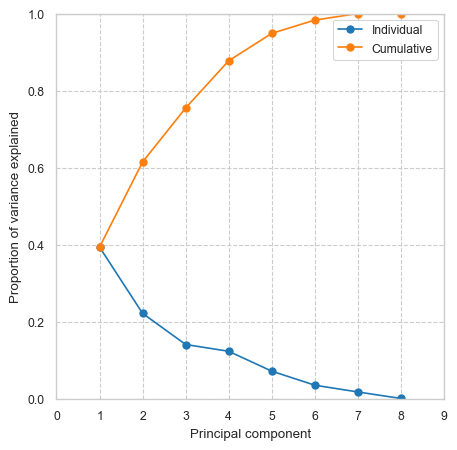

In [161]:
# create a variance-explained plot
xpos = range(1, len(features) + 1)
fig, ax = plt.subplots(figsize=(5, 5))
ax.plot(xpos, pve, marker='o', markersize=5, label='Individual')
ax.plot(xpos, np.cumsum(pve), marker='o', markersize=5, label='Cumulative')
ax.set_ylabel('Proportion of variance explained')
ax.set_xlabel('Principal component')
ax.set_xlim(0, len(features) + 1)
ax.set_ylim(0, 1)
ax.grid(True, ls='--')
_ = ax.legend()

### 5.2. Hierarchical clustering

In [162]:
# project onto first 4 principal components
X_reduced = PCA(n_components=4).fit_transform(X)
X_reduced.shape

(179, 4)

In [163]:
# calculate distance matrix then linkage matrix, choosing a method (algorithm)
distances = pdist(X_reduced)
Z = hierarchy.linkage(distances, method='complete', optimal_ordering=True)

In [164]:
# cophenetic correlation measures how well clustering preserved pairwise distances
c, _ = hierarchy.cophenet(Z, distances)
c

0.6912758709760717

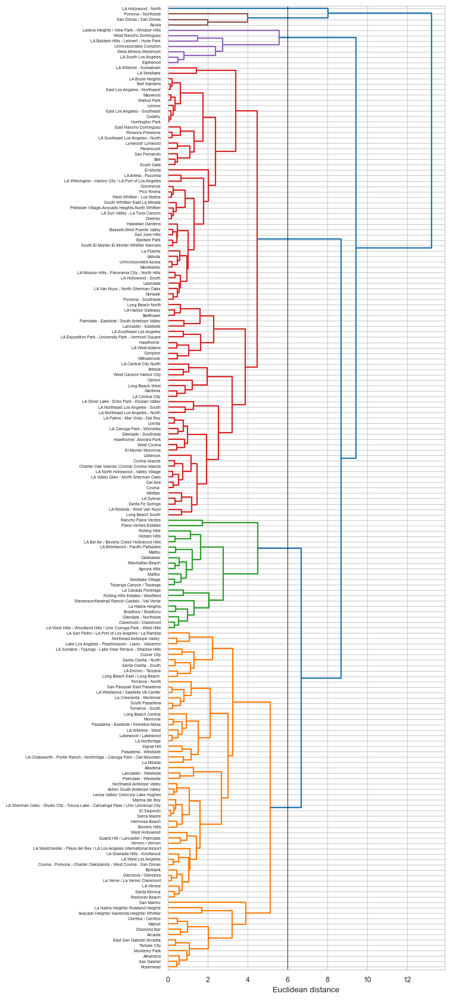

In [165]:
# pick a distance to cut dendrogram tree
cut_point = 6

# plot the dendrogram, colored by clusters below the cut point
fig, ax = plt.subplots(figsize=(6, 21))
ax.set_xlabel('Euclidean distance')
with plt.rc_context({'lines.linewidth': 1.6}):
    R = hierarchy.dendrogram(Z=Z,
                             orientation='right',
                             labels=pna_urban['Community'],
                             color_threshold=cut_point,
                             distance_sort='descending',
                             show_leaf_counts=False,
                             ax=ax)
plt.axvline(cut_point, c='k', linewidth=0.6)
fig.savefig('images/dendrogram.png', dpi=900, facecolor='w', bbox_inches='tight')

In [166]:
# assign k cluster labels to the observations, based on where you cut tree
# k = number of clusters = how many horizontal lines you intersected above
k = 6
cluster_labels = hierarchy.fcluster(Z, t=k, criterion='maxclust')
pd.Series(cluster_labels).value_counts().sort_index()

1     3
2     1
3    84
4    63
5    21
6     7
dtype: int64

## Conclusion
- The descriptive statistics show that an increase in green space per capita does not contribute to green space accessibility. 
- The street network analysis identifies that the density of walking and bicycling network are related. 
- However, the high portion of the green spaces tends to locate outside the high and middle centrality of the same case studies neighborhoods, meaning underutilizing the street network for green space and parks distribution purposes.
- Low-income and historically disadvantaged communities can be more isolated from green spaces and parks. However, big-scale green spaces in high-income neighborhoods associate with low walking and bicycling access.
- The research paper presents a comprehensive analysis of this notebook's deliverables. 